# AOS baseline test 

Testing convergence of code with simulation of one star

## 1) ComCam, *backgroundmode 0*

In [4]:
import os
import numpy as np
from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
import matplotlib.pyplot as plt
plt.style.use('dark_background')


In [444]:
topDir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestComCam')

cmd = 'python baseComcamLoop.py'
numPro = 15
iterNum = 5
testName = 'base'
args = '--numPro %d --iterNum %d --outputDir %s \
-clobber '%(numPro, iterNum, outputDir)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseComcamLoop.py --numPro 15 --iterNum 5 --outputDir /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam -clobber 


( before I ran the following):
    
python baseComcamLoop.py --numPro 15  --outputDir 
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTest/ --clobber 

and got the FWHM and PSSN to converge with new ts_wep  ISR settings and correct flats in phosim_utils make_gain_images ; results in /baselineTest/ 

NB: it used `starDefault.txt` and `opdDefault.txt`, which have `perturbationmode 1` but `backgroundmode 0`, i.e. no background ... 

In [18]:
from matplotlib.ticker import MaxNLocator

Text(0, 0.5, 'wavefront error of OPD $[\\mu m]$')

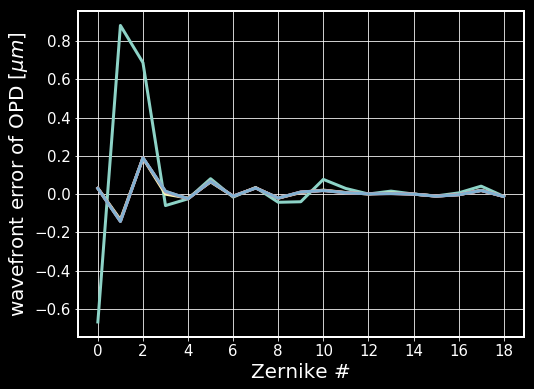

In [65]:
# Load the data 
data_dir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTest/'
opdDataDic = {}
wfsDataDic = {}
iterNum = 5

for iterCount in np.arange(iterNum):
    opdZkFilePath = os.path.join(data_dir,  'iter%d/img/opd.zer.1'%iterCount)
    opdData = np.loadtxt(opdZkFilePath)
    opdDataDic[iterCount] = opdData

    # show the bscDbType: file results for iter0 with no pert ... 
    wfsZkFilePath = os.path.join(data_dir,  'iter%d/img/wfs.zer.1'%iterCount)
    wfsData = np.loadtxt(wfsZkFilePath)
    wfsDataDic[iterCount] = wfsData

fig,ax = plt.subplots(1,1,figsize=(8,6))
# to compare the two, need  to somehow "average" the OPD ? 
# plot the values of zernikes at different field points...
for iterCount in range(iterNum):
    opdData = opdDataDic[iterCount]
#     for i in range(np.shape(opdData)[0]):
#         ax.plot(opdData[i,:], lw=1,ls='--')
    # plot the average of these ... 
    ax.plot(np.mean(opdData, axis=0), lw=3,ls='-' ,)

ax.grid()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
ax.set_xlabel('Zernike #')
ax.set_ylabel('wavefront error of OPD '+r'$[\mu m]$')

Text(0.5, 1.0, 'Zernike Errors WFS corner sensors arrows')

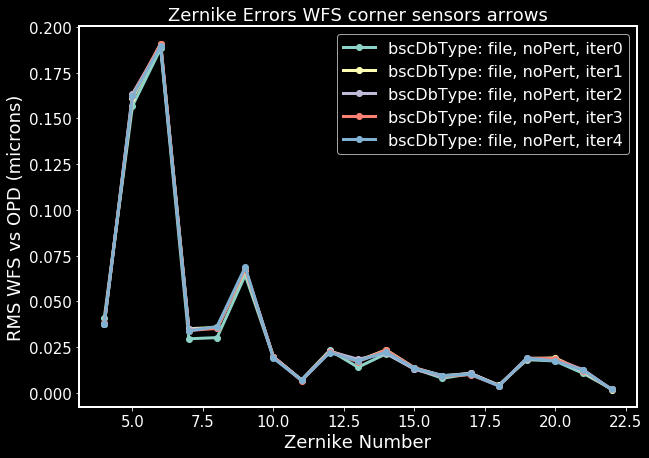

In [20]:
fig,ax = plt.subplots(1,1,figsize=(10,7))

for iterCount in range(iterNum):
    wfsData = wfsDataDic[iterCount]
    opdData = opdDataDic[iterCount]
    # do the difference with mean OPD ... 
    meanOpdData = np.mean(opdData, axis=0)
    zernikeErrorsDiff = np.sqrt((wfsData - meanOpdData)**2.)

    zernikeErrors = np.transpose(zernikeErrorsDiff, axes=(1,0))

    zernikeRms = np.sqrt(np.mean(np.square(zernikeErrors), axis=1))

    ax.plot(np.arange(19)+4, zernikeRms, 
                  '-o', lw=3, label='bscDbType: file, noPert, iter%d'%iterCount)

ax.set_xlabel('Zernike Number', size=18)
ax.set_ylabel('RMS WFS vs OPD (microns)', size=18)

ax.legend(fontsize=16)
ax.set_title('Zernike Errors WFS corner sensors arrows', size=18)


(array([0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95, 1.  ]),
 <a list of 10 Text yticklabel objects>)

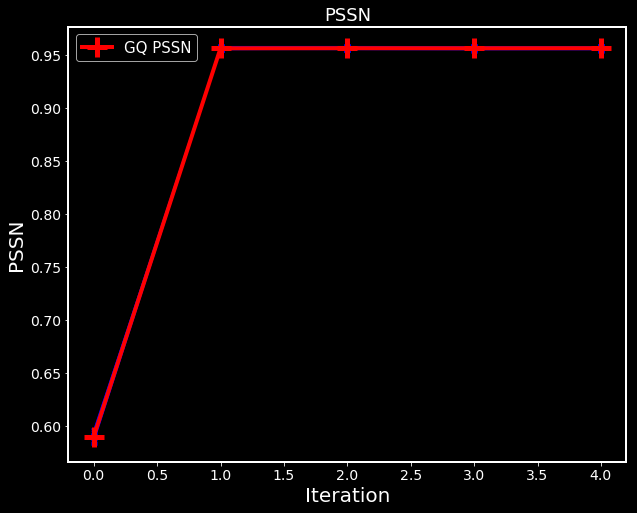

In [21]:
pssn_data = []
fwhm_data = []
num_iters=5
for iterNum in range(num_iters):
    pssn_filename = os.path.join(data_dir, 'iter%i' % iterNum, 'img/PSSN.txt')
    pssn_file_array = np.genfromtxt(pssn_filename)
    pssn_data.append(pssn_file_array[0])
    fwhm_data.append(pssn_file_array[1])
pssn_data = np.array(pssn_data)
fwhm_data = np.array(fwhm_data)

fig = plt.figure(figsize=(10, 8))
num_ccds = 9
for i in range(num_ccds):
    plt.plot(np.arange(num_iters), pssn_data[:,i], c='b', marker='x')
plt.plot(np.arange(num_iters), pssn_data[:,num_ccds], lw=4, marker='+',
         ms=20, markeredgewidth=5, c='r', label='GQ PSSN')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('PSSN')
plt.title('PSSN')
plt.xticks(size=14)
plt.yticks(size=14)

(array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6]), <a list of 6 Text yticklabel objects>)

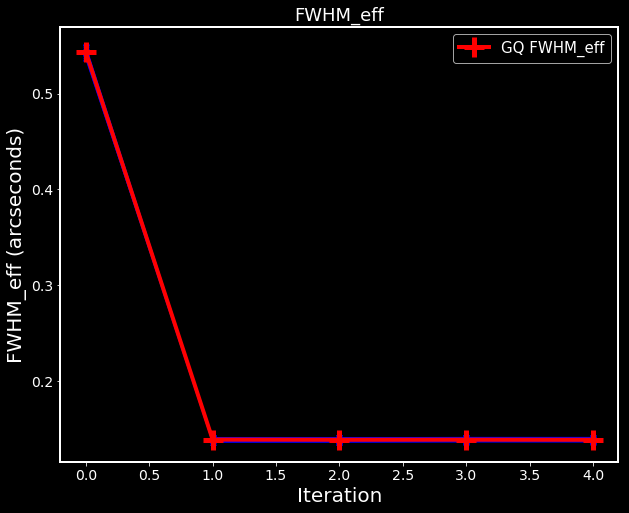

In [22]:
fig = plt.figure(figsize=(10, 8))
num_ccds = 9
for i in range(num_ccds):
    plt.plot(np.arange(num_iters), fwhm_data[:,i], c='b', marker='x')
plt.plot(np.arange(num_iters), fwhm_data[:,num_ccds], lw=4, marker='+',
         ms=20, markeredgewidth=5, c='r', label='GQ FWHM_eff')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('FWHM_eff (arcseconds)')
plt.title('FWHM_eff')
plt.xticks(size=14)
plt.yticks(size=14)

In [50]:
# Load the data 
data_dir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTest/'

def plot_iteration_summary(data_dir, iterNum=5, num_ccds=9, suptitle='', figname='1.png'):

    # two things to set 
    #iterNum = 5 # numer of iterations 
    #num_ccds = 9 # numer of CCDs at which OPD was evaluated 

    opdDataDic = {}
    wfsDataDic = {}
    pssn_data = []
    fwhm_data = []
    for iterCount in range(iterNum):
        # load the OPD data 
        opdZkFilePath = os.path.join(data_dir,  'iter%d/img/opd.zer.1'%iterCount)
        opdData = np.loadtxt(opdZkFilePath)
        opdDataDic[iterCount] = opdData

        # load the wavefront error data 
        wfsZkFilePath = os.path.join(data_dir,  'iter%d/img/wfs.zer.1'%iterCount)
        wfsData = np.loadtxt(wfsZkFilePath)
        wfsDataDic[iterCount] = wfsData

        # load the PSSN and FWHM data 
        pssn_filename = os.path.join(data_dir, 'iter%i' % iterCount, 'img/PSSN.txt')
        pssn_file_array = np.genfromtxt(pssn_filename)
        pssn_data.append(pssn_file_array[0])
        fwhm_data.append(pssn_file_array[1])
    pssn_data = np.array(pssn_data)
    fwhm_data = np.array(fwhm_data)


    fig,axs = plt.subplots(2,2,figsize=(16,12))
    ax = np.ravel(axs)

    # 0: plot the OPD 

    # to compare the two, need  to somehow "average" the OPD ? 
    # plot the values of zernikes at different field points...
    for iterCount in range(iterNum):
        opdData = opdDataDic[iterCount]
    #     for i in range(np.shape(opdData)[0]):
    #         ax.plot(opdData[i,:], lw=1,ls='--')
        # plot the average of these ... 
        ax[0].plot(np.mean(opdData, axis=0), lw=3,ls='-' ,)

    ax[0].set_xlabel('Zernike #')
    ax[0].set_ylabel('wavefront error of OPD '+r'$[\mu m]$')


    # 1: plot Zernike wavefront errors  vs OPD 
    for iterCount in range(iterNum):
        wfsData = wfsDataDic[iterCount]
        opdData = opdDataDic[iterCount]
        # do the difference with mean OPD ... 
        meanOpdData = np.mean(opdData, axis=0)
        zernikeErrorsDiff = np.sqrt((wfsData - meanOpdData)**2.)

        zernikeErrors = np.transpose(zernikeErrorsDiff, axes=(1,0))

        zernikeRms = np.sqrt(np.mean(np.square(zernikeErrors), axis=1))

        ax[1].plot(np.arange(19)+4, zernikeRms, 
                      '-o', lw=3, label='iter%d'%iterCount)

    ax[1].set_xlabel('Zernike Number', size=18)
    ax[1].set_ylabel('RMS WFS vs OPD (microns)', size=18)

    ax[1].legend(fontsize=16)
    ax[1].set_title('Zernike Errors WFS corner sensors arrows', size=18)


    # 2: plot PSSN 
    for i in range(num_ccds):
        ax[2].plot(np.arange(iterNum), pssn_data[:,i], c='b', marker='x')
    ax[2].plot(np.arange(iterNum), pssn_data[:,num_ccds], lw=4, marker='+',
             ms=20, markeredgewidth=5, c='r', label='GQ PSSN')
    ax[2].legend()
    ax[2].set_xlabel('Iteration')
    ax[2].set_ylabel('PSSN')
    ax[2].set_title('PSSN')
    # plt.xticks(size=14)
    # plt.yticks(size=14)


    # 3: plot the FWHM 
    for i in range(num_ccds):
        ax[3].plot(np.arange(iterNum), fwhm_data[:,i], c='b', marker='x')
    ax[3].plot(np.arange(iterNum), fwhm_data[:,num_ccds], lw=4, marker='+',
             ms=20, markeredgewidth=5, c='r', label='GQ FWHM_eff')
    ax[3].legend()
    ax[3].set_xlabel('Iteration')
    ax[3].set_ylabel('FWHM_eff (arcseconds)')
    ax[3].set_title('FWHM_eff')
    # plt.xticks(size=14)
    # plt.yticks(size=14)

    # on all : turn on the grid and set the x-label to be on integers only
    # since we're plotting Zernikes and iteration, both of which are integers
    for i in range(len(ax)):
        ax[i].grid()
        ax[i].xaxis.set_major_locator(MaxNLocator(integer=True))
    fig.subplots_adjust(hspace=0.3)
    fig.suptitle(suptitle)
    plt.savefig(figname, bbox_inches='tight')
    print('Saved fig as %s'%figname)

Saved fig as comcam_baseline_pert1_bkgnd0.png


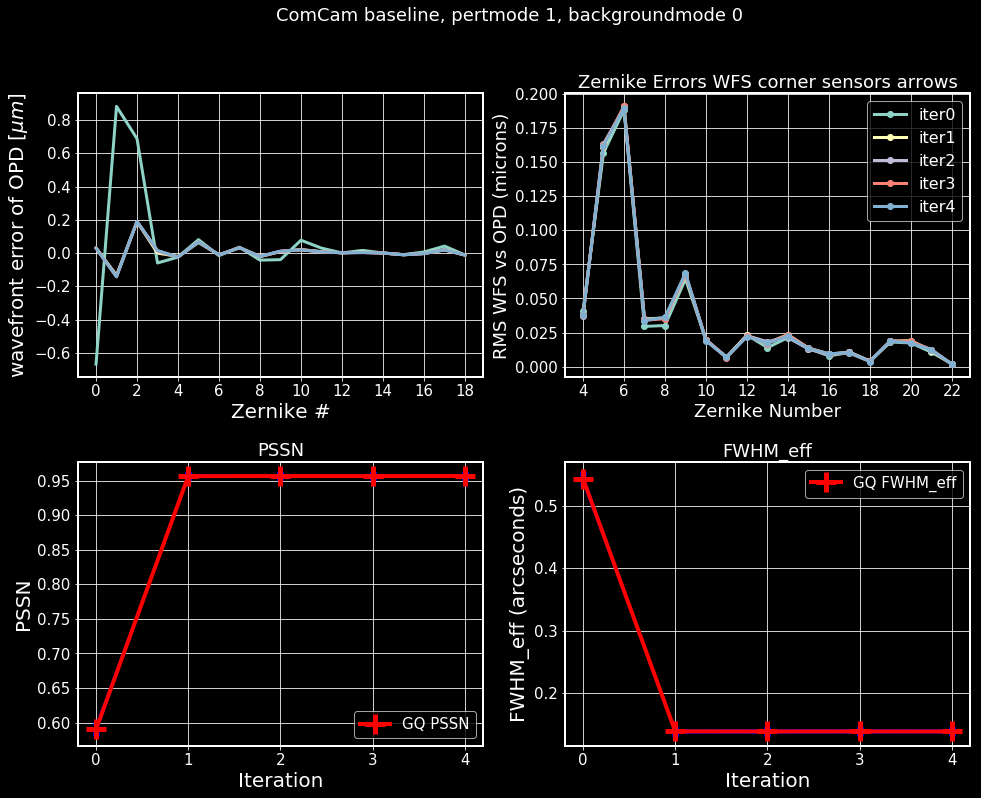

In [51]:
plot_iteration_summary(data_dir, suptitle='ComCam baseline, pertmode 1, backgroundmode 0',figname='comcam_baseline_pert1_bkgnd0.png')

# ComCam quickbackground , perturbationmode 1

In [2]:
import os 

topDir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestComCam_qbkg')

cmd = 'python baseAOSLoop.py'
numPro = 15
iterNum = 5
opdCmdSettingsFile = 'opdQuickBackground.cmd'
starCmdSettingsFile = 'starQuickBackground.cmd'
selectSensors = 'comcam'
args = '--numPro %d --iterNum %d --outputDir %s \
--opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --clobber'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 15 --iterNum 5 --outputDir /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg --opdCmdSettingsFile opdQuickBackground.cmd --starCmdSettingsFile starQuickBackground.cmd --selectSensors comcam --clobber


In [3]:
outputDir

'/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg'

Look at postISR images: 

data_id is
{'visit': 9006001, 'filter': 'g', 'raftName': 'R22', 'detectorName': 'S00', 'detector': 90}
Reading postISR images from the following repo_dir:
/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/input/rerun/run1
Done



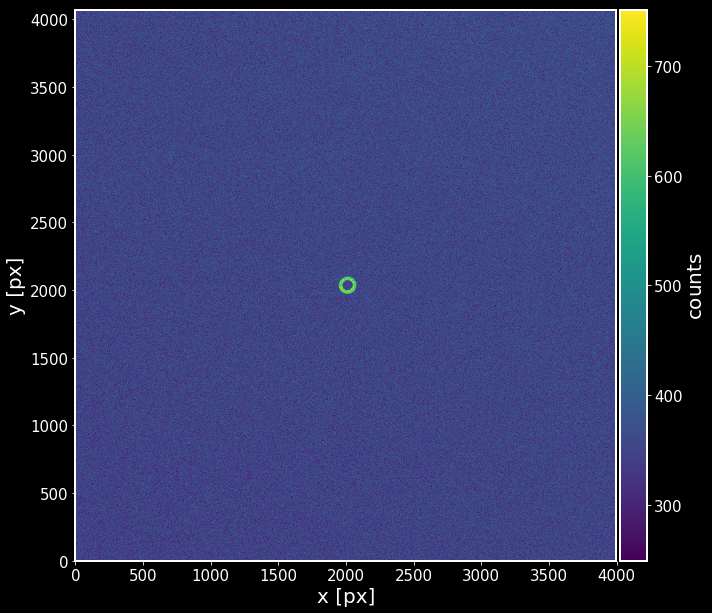

In [5]:
import sys
sys.path.append('../analysis_tools/')
import analysisTools as at 

image = at.readImage(outputDir,raft='R22',detector='S00')

at.plotImage(image)

In [14]:
at.plotImage??

Signature:
at.plotImage(
    image,
    ax=None,
    log=False,
    sensor='R22_S00',
    focalType='extra',
    postage=None,
    postFlag=False,
    centroid=None,
    centFlag=False,
    Nstars=2,
    starMarker='redCross',
    starMarkerArgs=None,
    centMarkerArgs=None,
    centMarker='redCross',
    starLabelArgs=None,
    plotArgs=None,
    imgType='postISR',
    addColorbar=True,
    addTitle=False,
    title='',
)
Source:   
def plotImage(image,ax=None, log=False, sensor='R22_S00', focalType='extra',
             postage=None,postFlag=False, centroid=None, centFlag=False, 
              Nstars=2, starMarker='redCross',starMarkerArgs=None,
             centMarkerArgs = None,centMarker='redCross',
             starLabelArgs=None, plotArgs=None, imgType='postISR',
             addColorbar = True, addTitle=False, title=''):
    ''' A function  to plot a CCD image

    Parameters:
    -----------
    image : an NxM image array with pixel values . 
        It will be transposed for

--> Running on baldur , screen `wfs` 

Saved fig as comcam_baseline_pert1_qckbkgnd.png


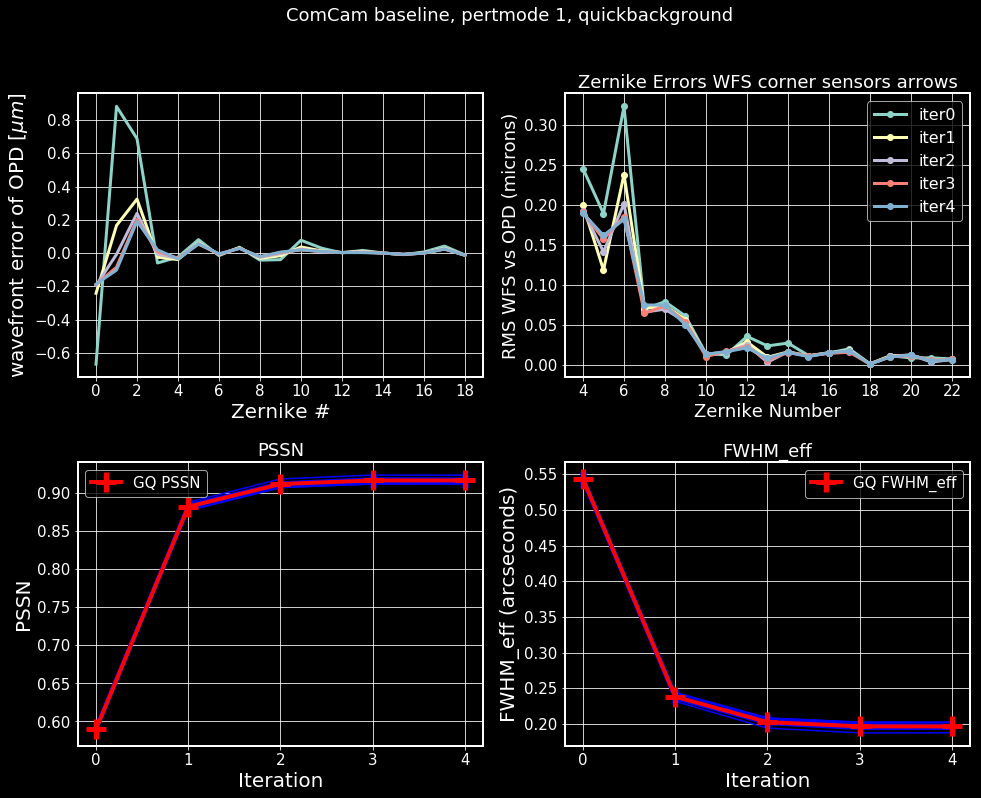

In [46]:
data_dir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg'
plot_iteration_summary(data_dir, suptitle='ComCam baseline, pertmode 1, quickbackground',
                      figname='comcam_baseline_pert1_qckbkgnd.png')

# ComCam quickbackground, perturbatiomode 0 

In [28]:
topDir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestComCam_qbkg_noPert')

cmd = 'python baseAOSLoop.py'
numPro = 15
iterNum = 5
testName = 'base'
opdCmdSettingsFile = 'opdQuickBackgroundNoPert.cmd'
starCmdSettingsFile = 'starQuickBackgroundNoPert.cmd'
selectSensors = 'comcam'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 15 --iterNum 5 --outputDir /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert  --opdCmdSettingsFile opdQuickBackgroundNoPert.cmd --starCmdSettingsFile starQuickBackgroundNoPert.cmd --selectSensors comcam


--> Running on baldur , screen `comcam` 

Saved fig as comcam_baseline_pert0_qckbkgnd.png


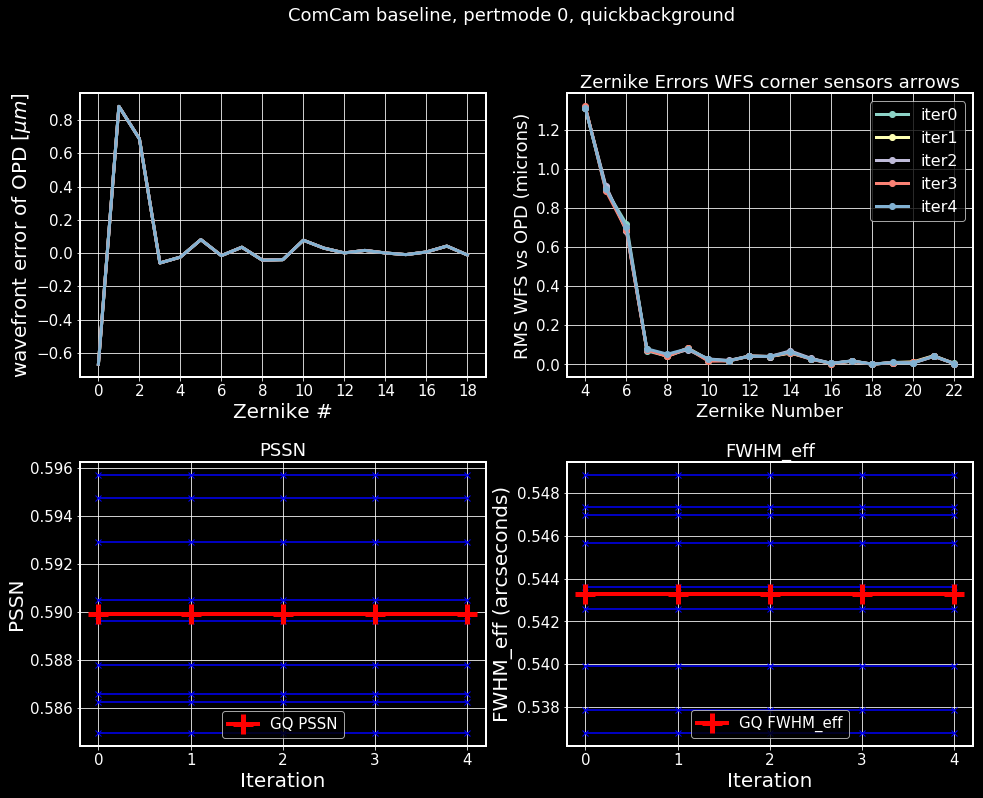

In [47]:
data_dir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert'
plot_iteration_summary(data_dir, suptitle='ComCam baseline, pertmode 0, quickbackground',
                      figname='comcam_baseline_pert0_qckbkgnd.png')

# ComCam quickbackground, perturbatiomode 0 , no subsys (actually no perturbations )

In [26]:
topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestComCam_qbkg_noPert2')

cmd = 'python baseAOSLoop.py'
numPro = 15
iterNum = 5
testName = 'base'
opdCmdSettingsFile = 'opdQuickBackgroundNoPert.cmd'
starCmdSettingsFile = 'starQuickBackgroundNoPert.cmd'
selectSensors = 'comcam'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --noPerturbations --clobber --dbFilename bsc4.db3'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 15 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert2  --opdCmdSettingsFile opdQuickBackgroundNoPert.cmd --starCmdSettingsFile starQuickBackgroundNoPert.cmd --selectSensors comcam --noPerturbations --clobber --dbFilename bsc4.db3


--> running on bendis, screen 'base'  

Saved fig as comcam_baseline_pert0_qckbkgnd_noPert.png


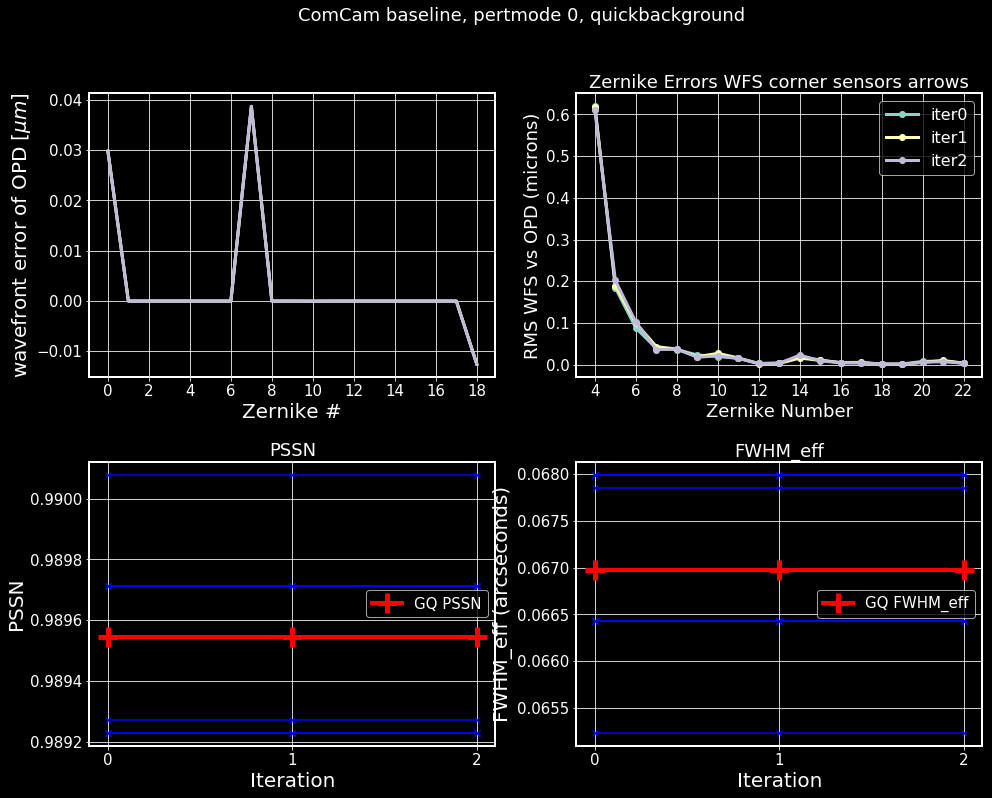

In [52]:
data_dir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert2'
plot_iteration_summary(data_dir, iterNum=3, suptitle='ComCam baseline, pertmode 0, quickbackground',
                      figname='comcam_baseline_pert0_qckbkgnd_noPert.png')

In [60]:
import sys
sys.path.append('../analysis_tools/')
import analysisTools as at 


In [67]:
# note : there was no postage for baselineTest recorded 
# postage_dir =  '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTest/iter1/postage/'
# at.plotPostageStamps(postage_dir, sensor='R22_S00', focalType='extra')

Using postage images from /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/iter1/postage/
Searching in /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/iter1/postage/ directory

Available postage stamp images for sensor R22_S00: 

Looking for files that start with "extra_singleSciImg" and contain "R22_S00"...

Found 1 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R22_S00_star-0_id-0_posX-2006_posY-2032.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R22_S00"...

Found 1 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R22_S00_star-0_id-0_posX-2006_posY-2032.txt']

Looking for files that start with "extra_imgDeblend_resized" and contain "R22_S00"...

Found 1 imgDeblend_resized postage stamp images 
['extra_imgDeblend_resized_sensor-R22_S00_star-0_id-0_posX-2006_posY-2032.txt']
Only found 1 
Loading extra_singleSciImg_sen

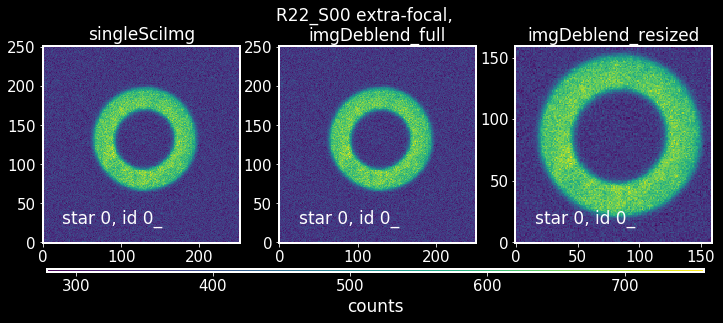

In [58]:
postage_dir =  '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/iter1/postage/'
at.plotPostageStamps(postage_dir, sensor='R22_S00', focalType='extra')

Using postage images from /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert/iter1/postage/
Searching in /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert/iter1/postage/ directory

Available postage stamp images for sensor R22_S00: 

Looking for files that start with "extra_singleSciImg" and contain "R22_S00"...

Found 1 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R22_S00_star-0_id-0_posX-2006_posY-2031.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R22_S00"...

Found 1 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R22_S00_star-0_id-0_posX-2006_posY-2031.txt']

Looking for files that start with "extra_imgDeblend_resized" and contain "R22_S00"...

Found 1 imgDeblend_resized postage stamp images 
['extra_imgDeblend_resized_sensor-R22_S00_star-0_id-0_posX-2006_posY-2031.txt']
Only found 1 
Loading extra_si

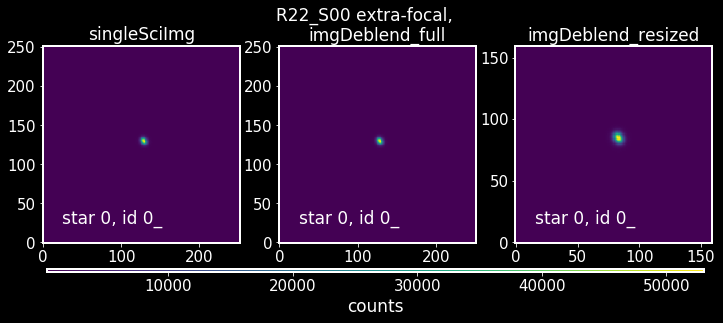

In [57]:
postage_dir =  '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert/iter1/postage/'
at.plotPostageStamps(postage_dir, sensor='R22_S00', focalType='extra')

Using postage images from /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert2/iter1/postage/
Searching in /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert2/iter1/postage/ directory

Available postage stamp images for sensor R22_S00: 

Looking for files that start with "extra_singleSciImg" and contain "R22_S00"...

Found 1 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R22_S00_star-0_id-0_posX-2006_posY-2031.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R22_S00"...

Found 1 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R22_S00_star-0_id-0_posX-2006_posY-2031.txt']

Looking for files that start with "extra_imgDeblend_resized" and contain "R22_S00"...

Found 1 imgDeblend_resized postage stamp images 
['extra_imgDeblend_resized_sensor-R22_S00_star-0_id-0_posX-2006_posY-2031.txt']
Only found 1 
Loading extra_

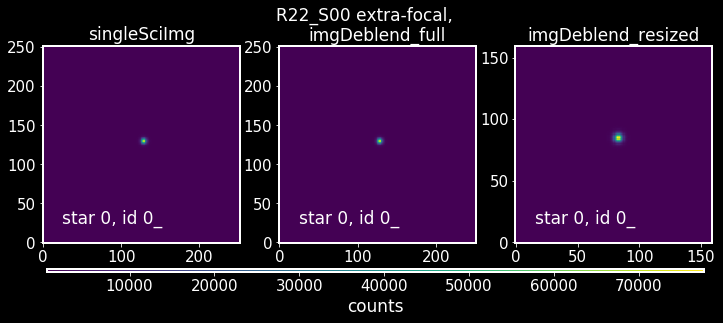

In [59]:
postage_dir =  '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg_noPert2/iter1/postage/'
at.plotPostageStamps(postage_dir, sensor='R22_S00', focalType='extra')

In [40]:
data_dir='/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg'
image = at.readImage(data_dir,raft='R22',detector='S00')

data_id is
{'visit': 9006001, 'filter': 'g', 'raftName': 'R22', 'detectorName': 'S00', 'detector': 90}
Reading postISR images from the following repo_dir:
/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/input/rerun/run1
Done



In [42]:
os.listdir(os.path.join(data_dir,'iter0'))

['pert', 'img', 'postage']

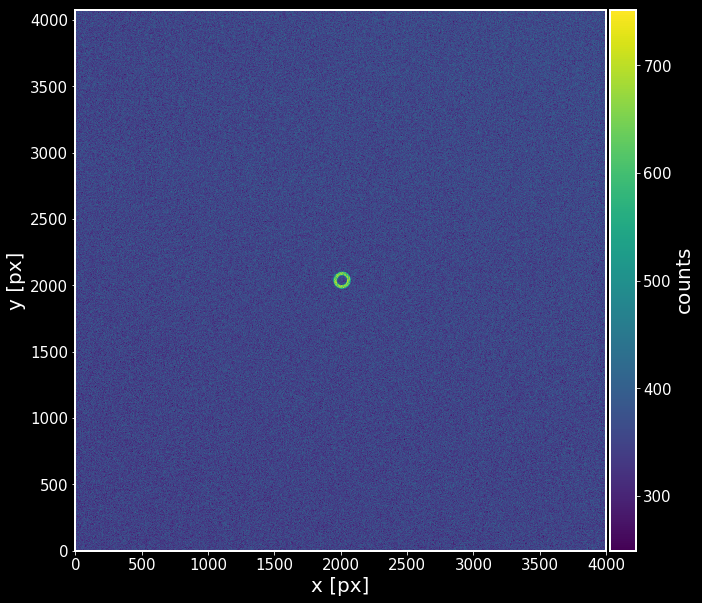

In [75]:
at.plotImage(image)

Using postage images from /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/iter0/postage
Searching in /epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestComCam_qbkg/iter0/postage directory

Available postage stamp images for sensor R22_S00: 

Looking for files that start with "extra_singleSciImg" and contain "R22_S00"...

Found 1 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R22_S00_star-0_id-0_posX-2006_posY-2032.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R22_S00"...

Found 1 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R22_S00_star-0_id-0_posX-2006_posY-2032.txt']

Looking for files that start with "extra_imgDeblend_resized" and contain "R22_S00"...

Found 1 imgDeblend_resized postage stamp images 
['extra_imgDeblend_resized_sensor-R22_S00_star-0_id-0_posX-2006_posY-2032.txt']
Only found 1 
Loading extra_singleSciImg_senso

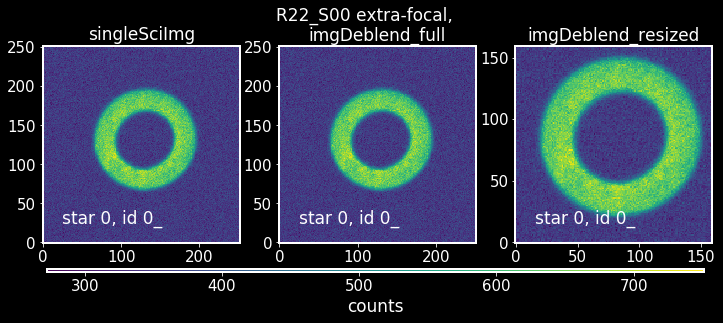

In [44]:
at.plotPostageStamps(postage_dir = os.path.join(data_dir,'iter0/postage'))

ok, so `perturbationmode 0` doesn't make sense for comcam since then there is no defocal movement to make donuts in the first place ... How about WFS ? 

# LsstFamCam : three sensors closest to one wavefront sensor 
    The four closest are R14, R34, R10 and R30 . 

In [681]:
topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestLsstFamCam_R14_S00')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
testName = 'base'
bscDbType= 'file'
opdCmdSettingsFile = 'opdDefault.cmd'
starCmdSettingsFile = 'starDefault.cmd'
selectSensors = 'lsstfamcam'
sensorNamesString = 'R13_S02|R14_S00|R03_S22'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --sensors "%s" --clobber --dbFileName bsc4.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, sensorNamesString, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefault.cmd --selectSensors lsstfamcam --sensors "R13_S02|R14_S00|R03_S22" --clobber --dbFileName bsc4.db3 --bscDbType file


Show the postISR image : 

In [583]:
import imp
imp.reload(at)

<module 'analysisTools' from '../analysis_tools/analysisTools.py'>

data_id is
{'visit': 9006001, 'filter': 'g', 'raftName': 'R03', 'detectorName': 'S22', 'detector': 26}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00/input/rerun/run1
Done

data_id is
{'visit': 9006011, 'filter': 'g', 'raftName': 'R03', 'detectorName': 'S22', 'detector': 26}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00/input/rerun/run1
Done

data_id is
{'visit': 9006021, 'filter': 'g', 'raftName': 'R03', 'detectorName': 'S22', 'detector': 26}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00/input/rerun/run1
Done



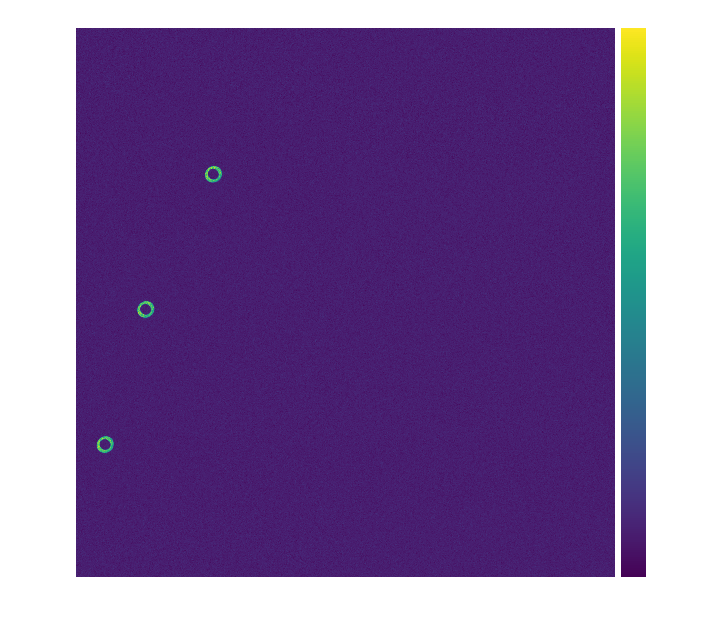

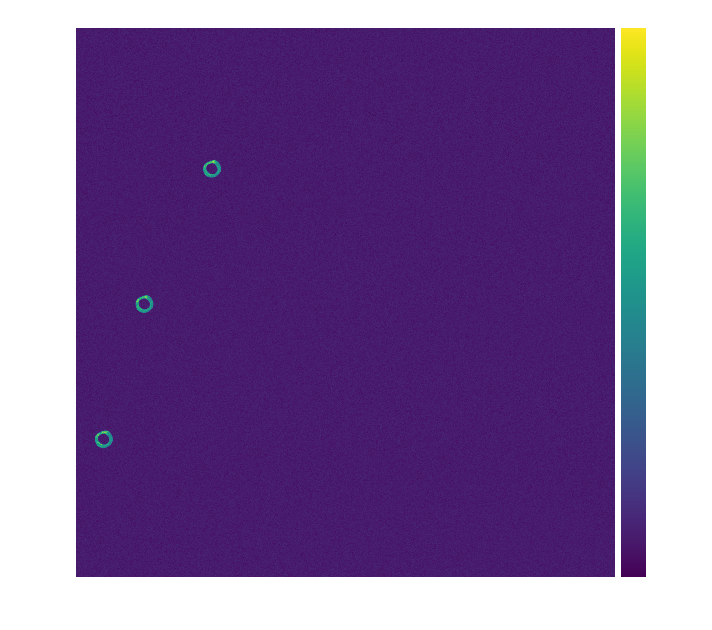

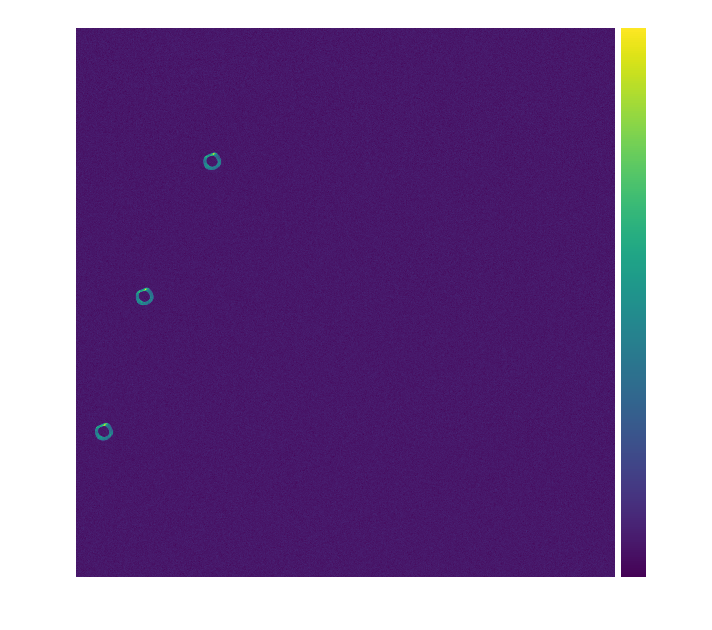

In [588]:
raft='R03' ; detector='S22'  ; detNum = 26 
for iterNum in [0,1,2]:
    image = at.readImage(outputDir, raft=raft, detector=detector, detNum=detNum, iterNum=iterNum)
    sensor = '%s_%s'%(raft,detector)
    at.plotImage(image,addTitle=True, title = sensor+', iter%d, '%iterNum+ ' postISR')

In [596]:
imp.reload(at)

<module 'analysisTools' from '../analysis_tools/analysisTools.py'>

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00/iter2/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00/iter2/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-6_posX-209_posY-1069.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-7_posX-509_posY-2067.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-8_posX-1009_posY-3068.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-6_posX-209_posY-1069.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-7_posX-509_posY-2067.txt', 'extra_

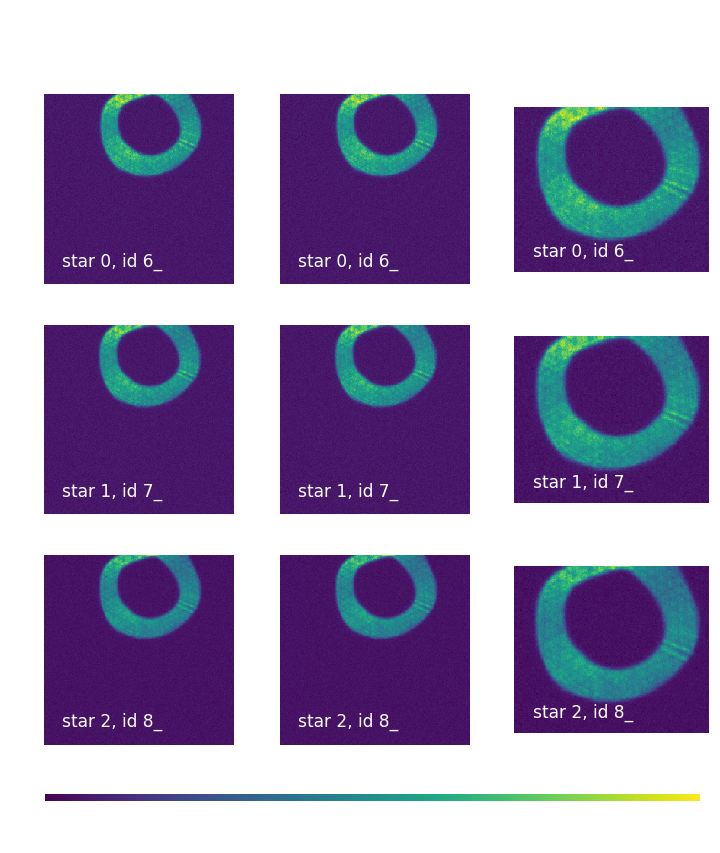

In [599]:
iterNum=2
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d.png'%(sensor,iterNum), suptitle='%s, iter%d'%(sensor,iterNum))

Saved fig as 1.png


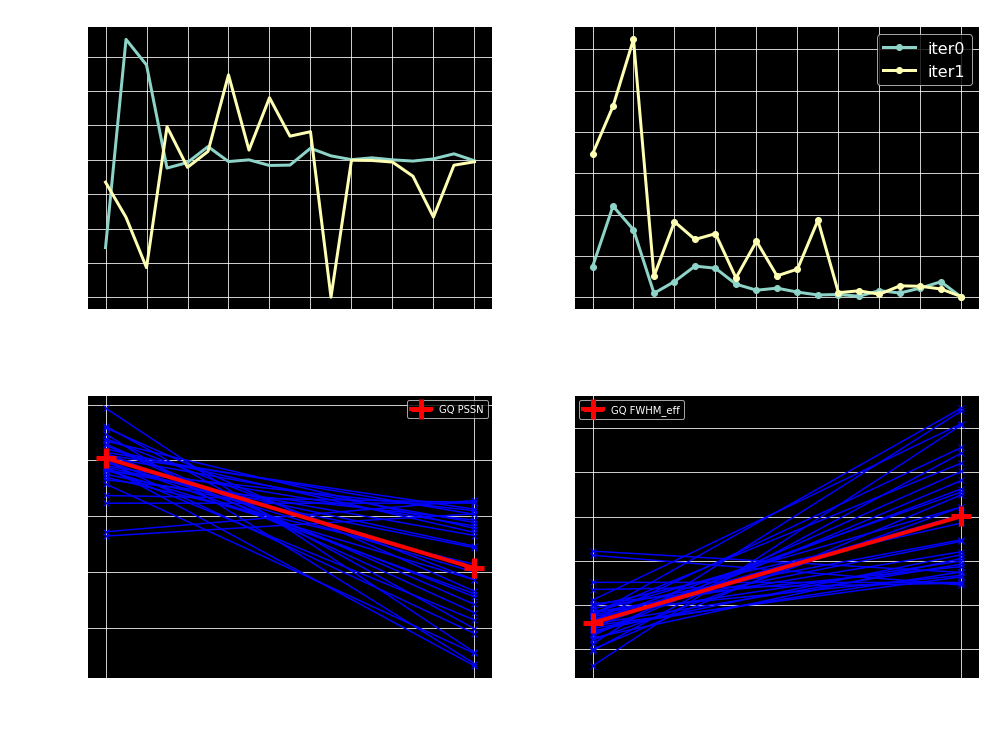

In [600]:
at.plotIterationSummary(outputDir,num_ccds=31,iterNum=2) 

# ( can't do more as the process fails after the second iteration due to location of the donut being completely off ... )

### Use three sensors closest to a corner sensor but use bscDbType:image 

In [701]:
topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestLsstFamCam_R14_S00_3sensors')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
testName = 'base'
bscDbType= 'image'
opdCmdSettingsFile = 'opdDefault.cmd'
starCmdSettingsFile = 'starDefault.cmd'
selectSensors = 'lsstfamcam'
sensorNamesString = 'R13_S02|R14_S00|R03_S22'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --sensors "%s" --clobber --dbFileName bsc4.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, sensorNamesString, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefault.cmd --selectSensors lsstfamcam --sensors "R13_S02|R14_S00|R03_S22" --clobber --dbFileName bsc4.db3 --bscDbType image


Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter0/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-0_posX-3004_posY-2994.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-1_posX-1005_posY-995.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-2_posX-2005_posY-1995.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-0_posX-3004_posY-2994.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-1_posX-1005_po

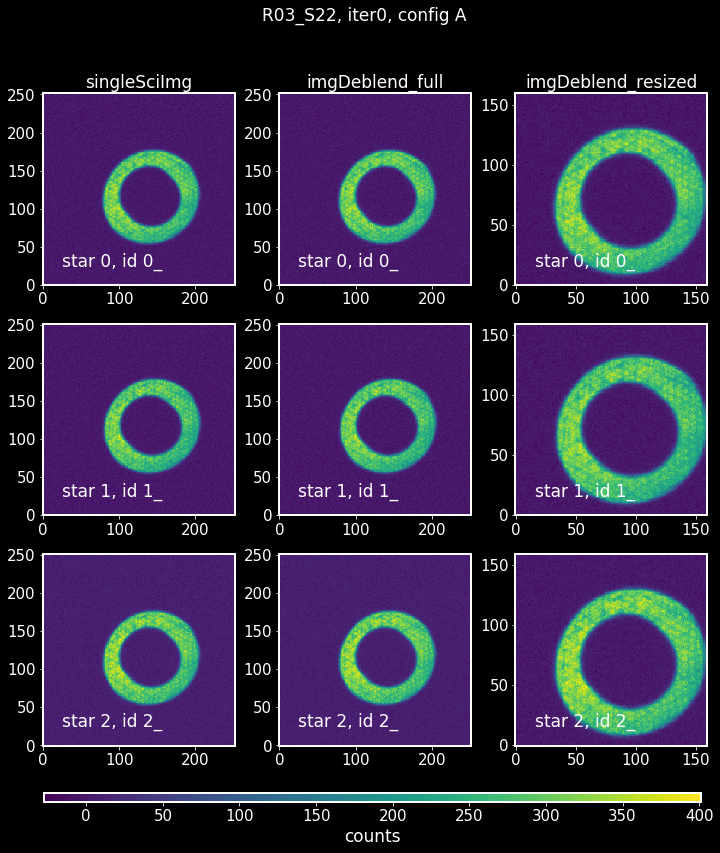

In [688]:
iterNum=0
sensor = 'R03_S22'
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_3sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config A'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter1/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter1/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-0_posX-2993_posY-3022.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-1_posX-994_posY-1023.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-2_posX-1993_posY-2022.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-0_posX-2993_posY-3022.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-1_posX-994_pos

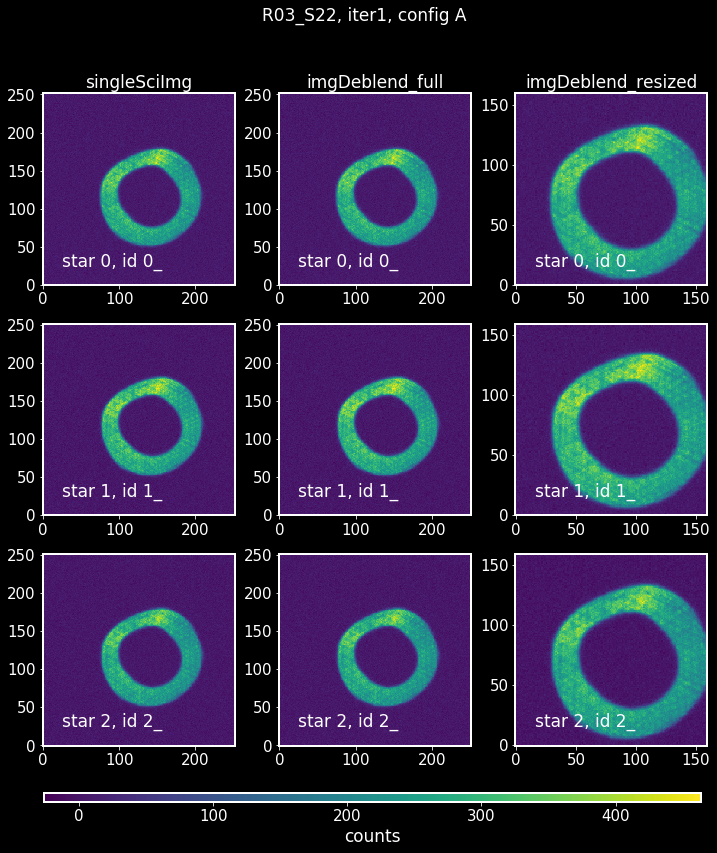

In [689]:
iterNum=1
sensor = 'R03_S22'
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_3sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config A'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter2/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter2/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-0_posX-2994_posY-3070.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-1_posX-1994_posY-2070.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-2_posX-995_posY-1070.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-0_posX-2994_posY-3070.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-1_posX-1994_po

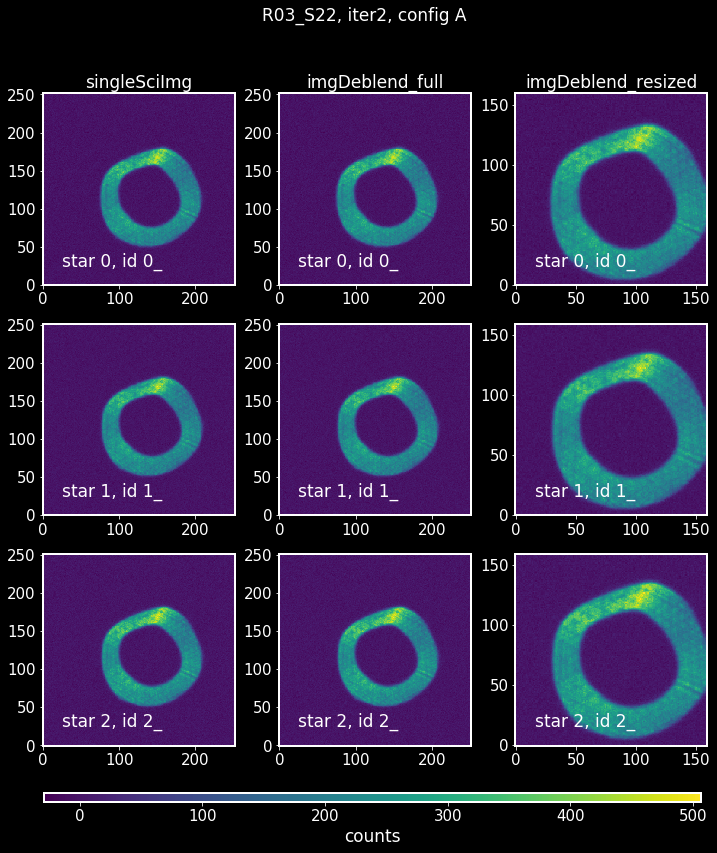

In [702]:
iterNum=2
sensor = 'R03_S22'
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_3sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config A'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter3/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_3sensors/iter3/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-0_posX-997_posY-1109.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-1_posX-1997_posY-2109.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-2_posX-2996_posY-3108.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-0_posX-997_posY-1109.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-1_posX-1997_pos

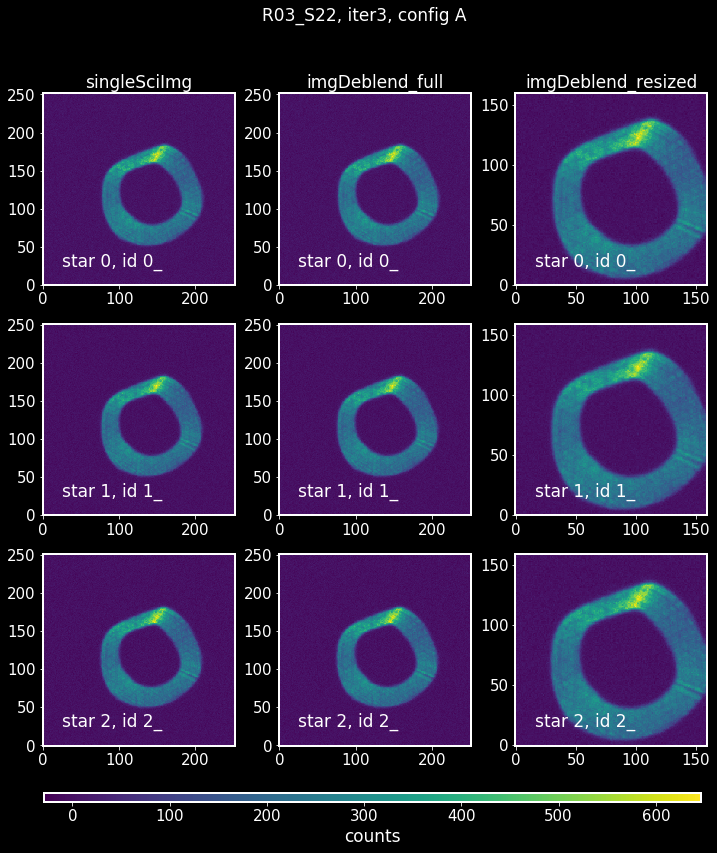

In [703]:
iterNum=3
sensor = 'R03_S22'
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_3sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config A'%(sensor,iterNum))

## Do the three sensors around each corner sensor,  in total twelve , and use  bscDbType: image ... 

In [692]:
##### topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestLsstFamCam_R14_S00_image3')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
testName = 'base'
opdCmdSettingsFile = 'opdDefault.cmd'
starCmdSettingsFile = 'starDefault.cmd'
selectSensors = 'lsstfamcam'
bscDbType = 'image'
topLeft = 'R03_S22|R13_S02|R14_S00|'
topRight = 'R34_S20|R33_S22|R43_S02|'
bottomLeft = 'R01_S20|R11_S00|R10_S02|'
bottomRight = 'R30_S22|R31_S20|R41_S00'

sensorNamesString = topLeft+topRight+bottomLeft+bottomRight
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --sensors "%s"  --bscDbType %s --dbFileName bsc3.db3 '%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, sensorNamesString, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefault.cmd --selectSensors lsstfamcam --sensors "R03_S22|R13_S02|R14_S00|R34_S20|R33_S22|R43_S02|R01_S20|R11_S00|R10_S02|R30_S22|R31_S20|R41_S00"  --bscDbType image --dbFileName bsc3.db3 


data_id is
{'visit': 9006001, 'filter': 'g', 'raftName': 'R03', 'detectorName': 'S22', 'detector': 26}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/input/rerun/run1
Done



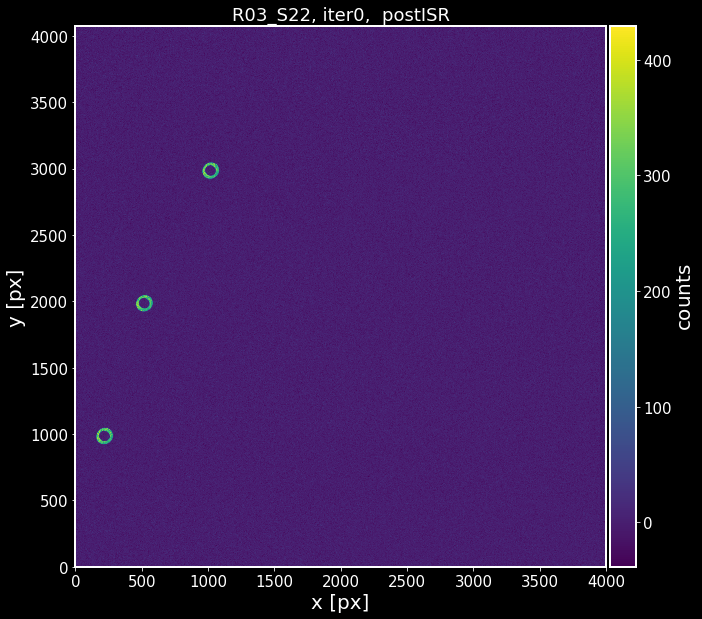

In [645]:
raft='R03' ; detector='S22'  ; detNum = 26 
for iterNum in [0]:
    image = at.readImage(outputDir, raft=raft, detector=detector, detNum=detNum, iterNum=iterNum)
    sensor = '%s_%s'%(raft,detector)
    at.plotImage(image,addTitle=True, title = sensor+', iter%d, '%iterNum+ ' postISR')

data_id is
{'visit': 9006011, 'filter': 'g', 'raftName': 'R03', 'detectorName': 'S22', 'detector': 26}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/input/rerun/run1
Done



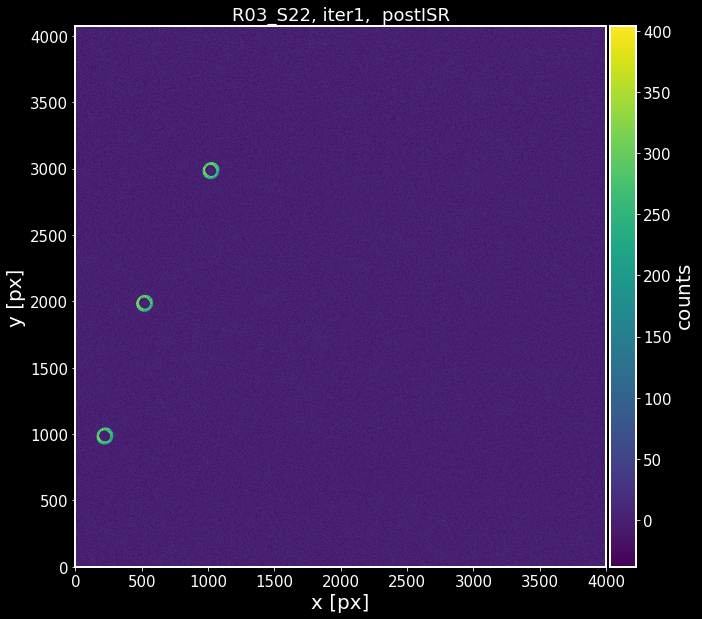

In [653]:
iterNum=1
image = at.readImage(outputDir, raft=raft, detector=detector, detNum=detNum, iterNum=iterNum)
sensor = '%s_%s'%(raft,detector)
at.plotImage(image,addTitle=True, title = sensor+', iter%d, '%iterNum+ ' postISR')

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter0/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-3_posX-505_posY-1995.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-4_posX-205_posY-995.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-5_posX-1005_posY-2995.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-3_posX-505_posY-1995.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-4_posX-205_posY-995.t

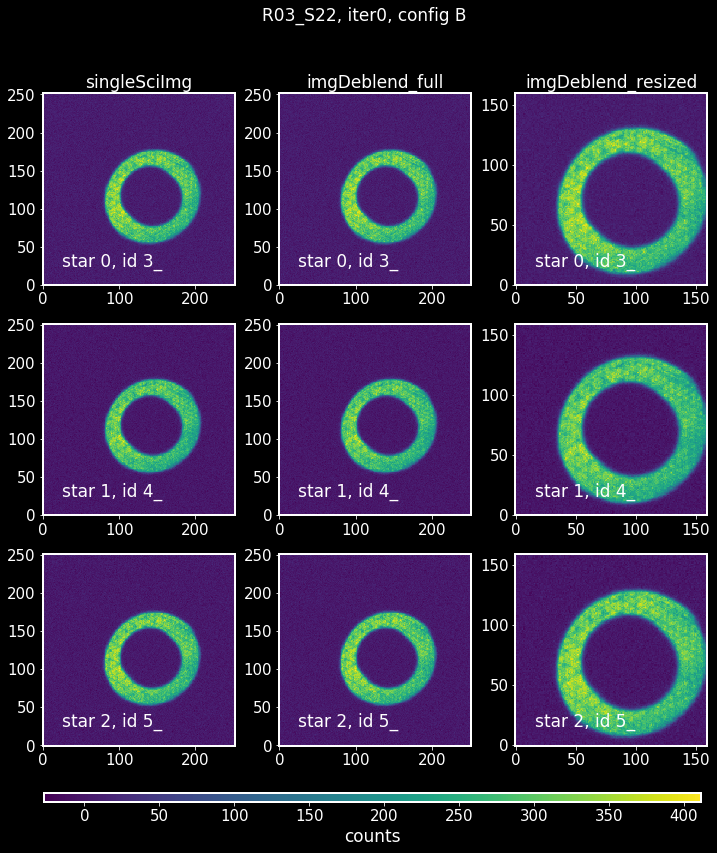

In [693]:
#for iterNum in range(2):# iterNum
iterNum=0
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_12sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config B'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter1/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter1/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-3_posX-208_posY-996.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-4_posX-507_posY-1995.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-5_posX-1007_posY-2995.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-3_posX-208_posY-996.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-4_posX-507_posY-1995.t

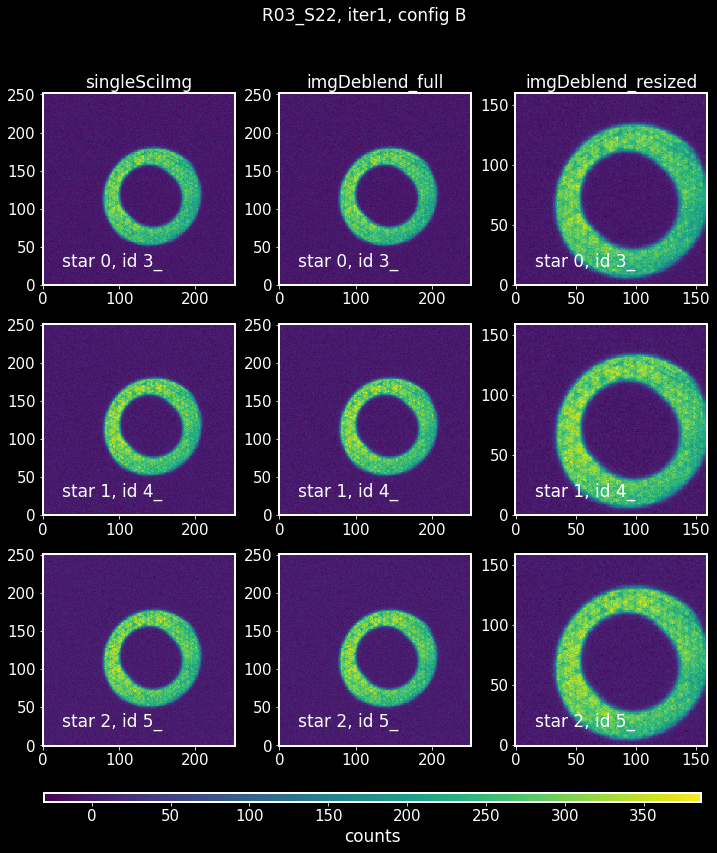

In [694]:
#for iterNum in range(2):# iterNum
iterNum=1
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_12sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config B'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter2/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter2/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-3_posX-508_posY-1995.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-4_posX-208_posY-995.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-5_posX-1008_posY-2994.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-3_posX-508_posY-1995.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-4_posX-208_posY-995.t

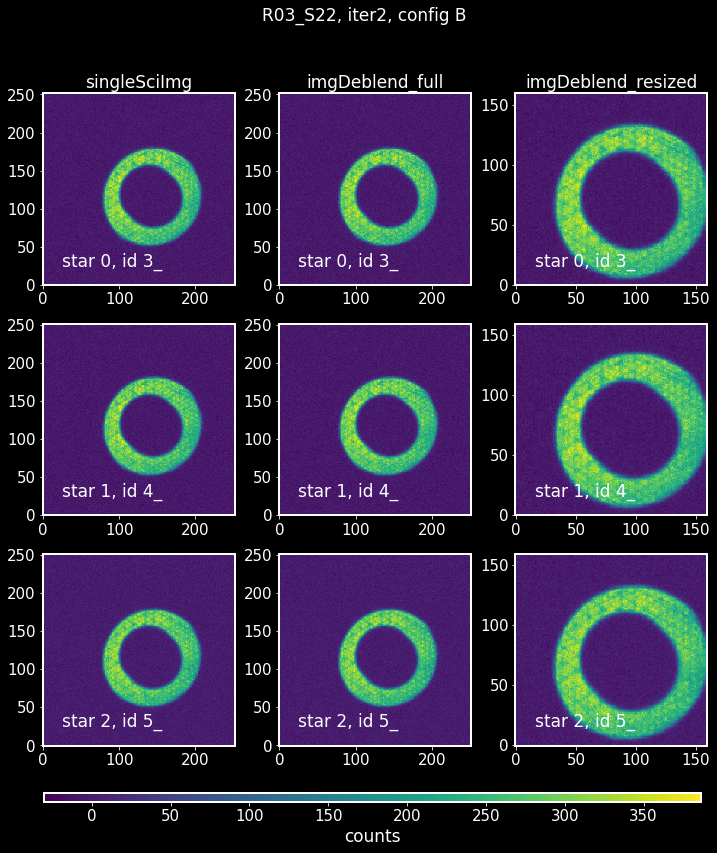

In [695]:
#for iterNum in range(2):# iterNum
iterNum=2
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_12sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config B'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter4/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image3/iter4/postage directory

Available postage stamp images for sensor R03_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R03_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R03_S22_star-0_id-3_posX-508_posY-1995.txt', 'extra_singleSciImg_sensor-R03_S22_star-1_id-4_posX-208_posY-995.txt', 'extra_singleSciImg_sensor-R03_S22_star-2_id-5_posX-1008_posY-2994.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R03_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R03_S22_star-0_id-3_posX-508_posY-1995.txt', 'extra_imgDeblend_full_sensor-R03_S22_star-1_id-4_posX-208_posY-995.t

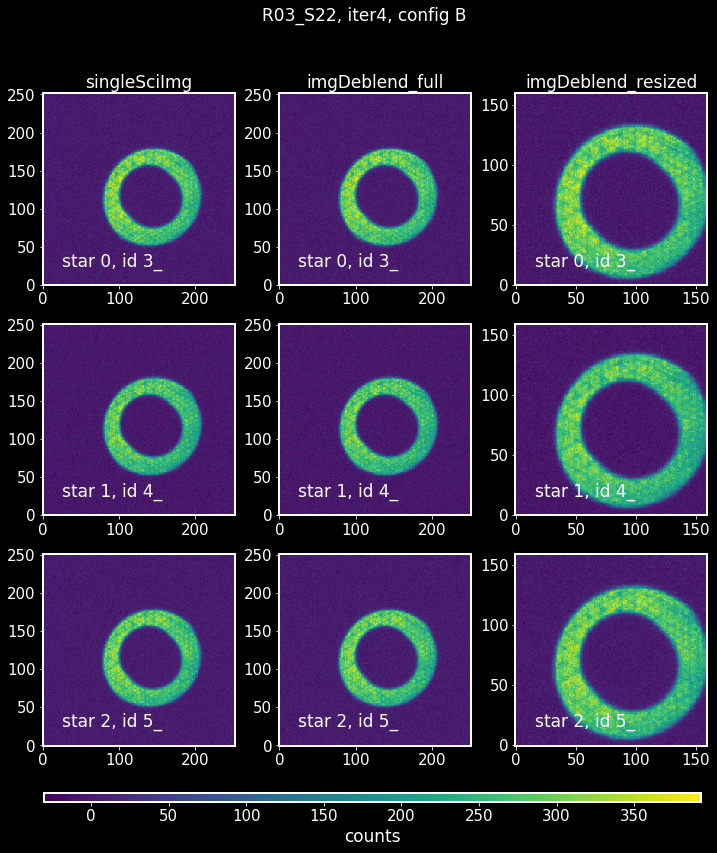

In [696]:
#for iterNum in range(2):# iterNum
iterNum=4
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_12sensors.png'%(sensor,iterNum), suptitle='%s, iter%d, config B'%(sensor,iterNum))

Saved fig as 1.png


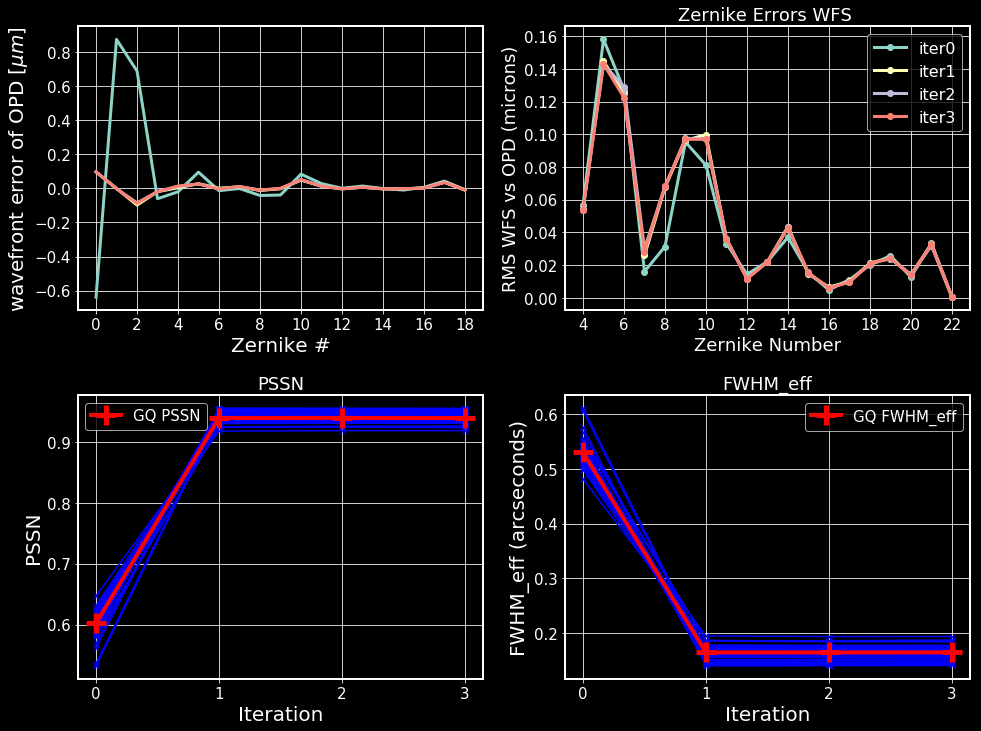

In [662]:
at.plotIterationSummary(outputDir,num_ccds=31,iterNum=4) 

## One sensor near each corner  (4sensors)

In [697]:
##### topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/'
outputDir = os.path.join(topDir,'baselineTestLsstFamCam_R14_S00_image_4sensors')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
testName = 'base'
opdCmdSettingsFile = 'opdDefault.cmd'
starCmdSettingsFile = 'starDefault.cmd'
selectSensors = 'lsstfamcam'
bscDbType = 'image'
topLeft = 'R14_S00|'
topRight = 'R34_S20|'
bottomLeft = 'R10_S02|'
bottomRight = 'R30_S22'

sensorNamesString = topLeft+topRight+bottomLeft+bottomRight
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --sensors "%s"  --bscDbType %s --dbFileName bsc3.db3 '%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, sensorNamesString, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefault.cmd --selectSensors lsstfamcam --sensors "R14_S00|R34_S20|R10_S02|R30_S22"  --bscDbType image --dbFileName bsc3.db3 


Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage directory

Available postage stamp images for sensor R30_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R30_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R30_S22_star-0_id-6_posX-2994_posY-3006.txt', 'extra_singleSciImg_sensor-R30_S22_star-1_id-7_posX-1994_posY-2007.txt', 'extra_singleSciImg_sensor-R30_S22_star-2_id-8_posX-995_posY-1007.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R30_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R30_S22_star-0_id-6_posX-2994_posY-3006.txt', 'extra_imgDeblend_full_sensor-R30_S22_star-1_id-7_

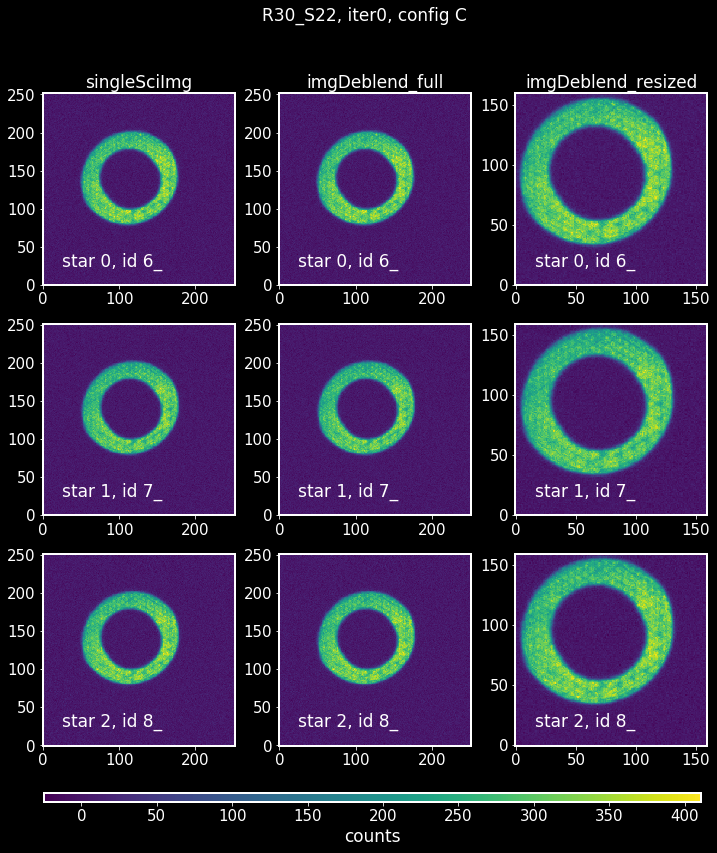

In [698]:
#for iterNum in range(2):# iterNum
sensor = 'R30_S22'
iterNum=0
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_4sensors.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d, config C'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter1/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter1/postage directory

Available postage stamp images for sensor R30_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R30_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R30_S22_star-0_id-6_posX-2996_posY-3007.txt', 'extra_singleSciImg_sensor-R30_S22_star-1_id-7_posX-1996_posY-2007.txt', 'extra_singleSciImg_sensor-R30_S22_star-2_id-8_posX-997_posY-1008.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R30_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R30_S22_star-0_id-6_posX-2996_posY-3007.txt', 'extra_imgDeblend_full_sensor-R30_S22_star-1_id-7_

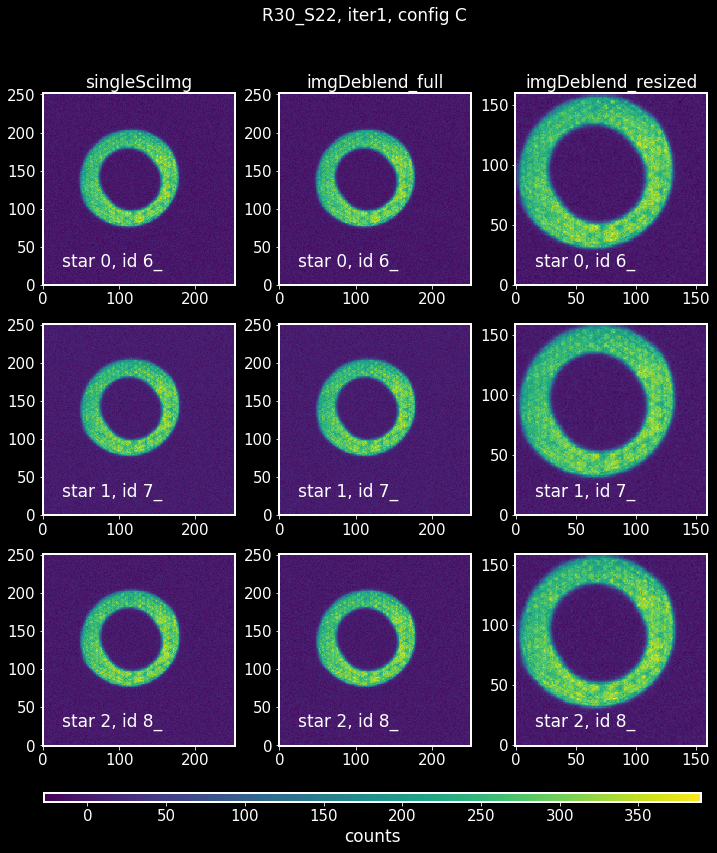

In [699]:
#for iterNum in range(2):# iterNum
sensor = 'R30_S22'
iterNum=1
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_4sensors.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d, config C'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter2/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter2/postage directory

Available postage stamp images for sensor R30_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R30_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R30_S22_star-0_id-6_posX-1996_posY-2007.txt', 'extra_singleSciImg_sensor-R30_S22_star-1_id-7_posX-2996_posY-3006.txt', 'extra_singleSciImg_sensor-R30_S22_star-2_id-8_posX-996_posY-1007.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R30_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R30_S22_star-0_id-6_posX-1996_posY-2007.txt', 'extra_imgDeblend_full_sensor-R30_S22_star-1_id-7_

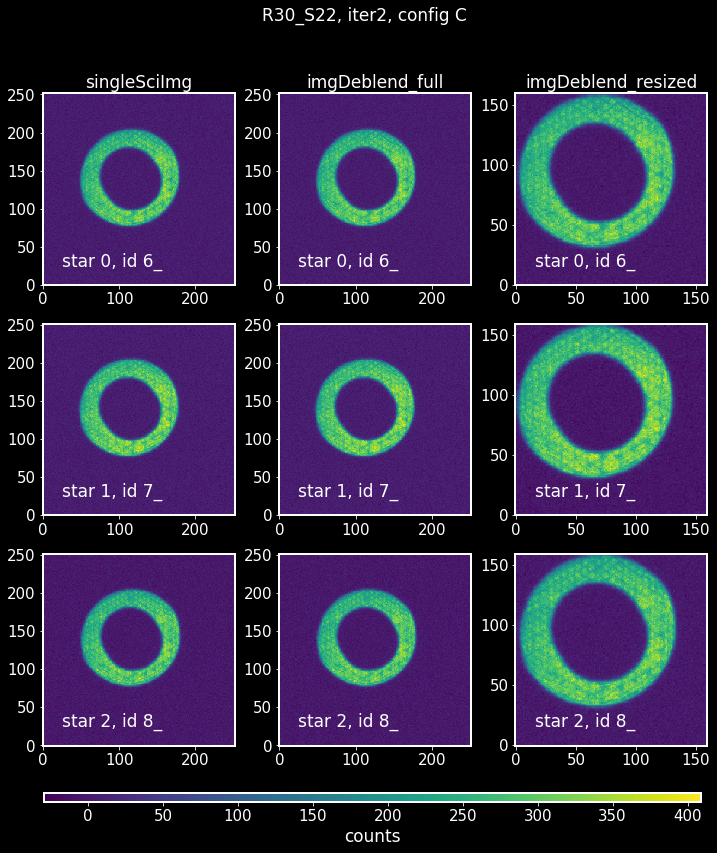

In [700]:
#for iterNum in range(2):# iterNum
sensor = 'R30_S22'
iterNum=2
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_4sensors.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d, config C'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage directory

Available postage stamp images for sensor R34_S20: 

Looking for files that start with "extra_singleSciImg" and contain "R34_S20"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R34_S20_star-0_id-9_posX-994_posY-992.txt', 'extra_singleSciImg_sensor-R34_S20_star-1_id-10_posX-1994_posY-1991.txt', 'extra_singleSciImg_sensor-R34_S20_star-2_id-11_posX-2993_posY-2991.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R34_S20"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R34_S20_star-0_id-9_posX-994_posY-992.txt', 'extra_imgDeblend_full_sensor-R34_S20_star-1_id-10_

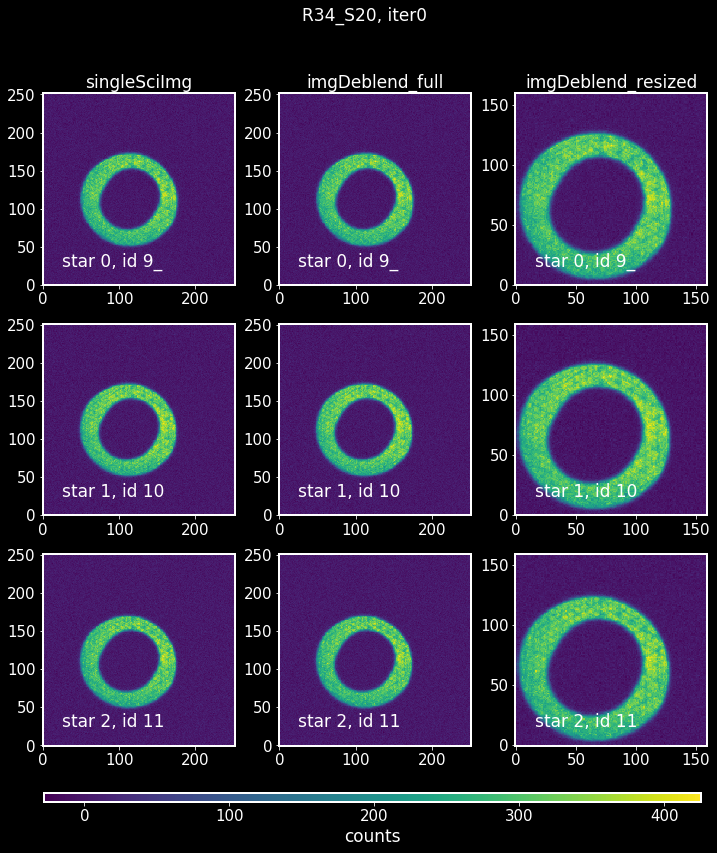

In [676]:
#for iterNum in range(2):# iterNum
sensor = 'R34_S20'
iterNum=0
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_image.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage directory

Available postage stamp images for sensor R14_S00: 

Looking for files that start with "extra_singleSciImg" and contain "R14_S00"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R14_S00_star-0_id-3_posX-2003_posY-1993.txt', 'extra_singleSciImg_sensor-R14_S00_star-1_id-4_posX-1004_posY-994.txt', 'extra_singleSciImg_sensor-R14_S00_star-2_id-5_posX-3003_posY-2993.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R14_S00"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R14_S00_star-0_id-3_posX-2003_posY-1993.txt', 'extra_imgDeblend_full_sensor-R14_S00_star-1_id-4_

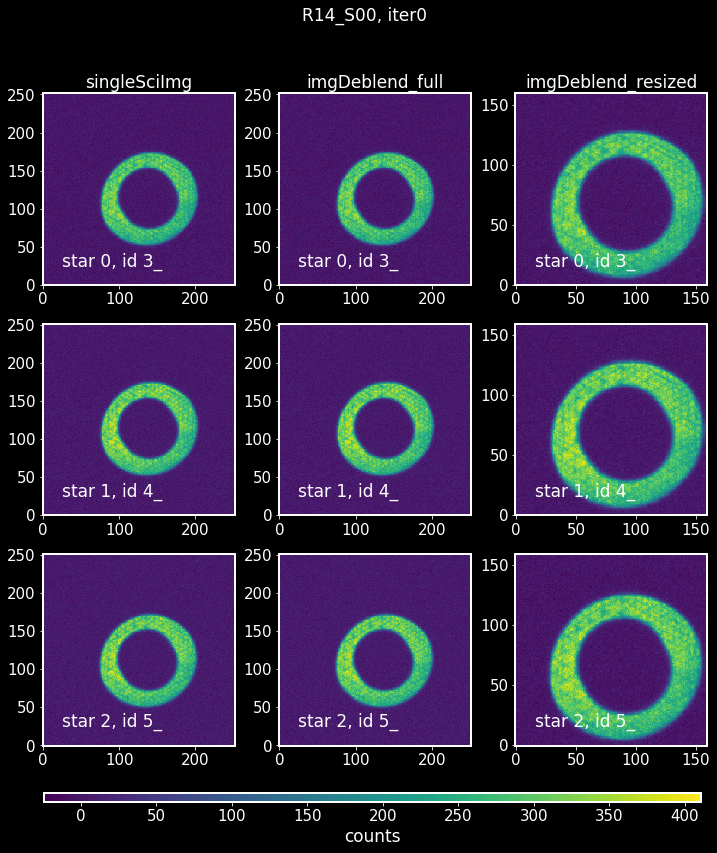

In [675]:
#for iterNum in range(2):# iterNum
sensor = 'R14_S00'
iterNum=0
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_image.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter0/postage directory

Available postage stamp images for sensor R10_S02: 

Looking for files that start with "extra_singleSciImg" and contain "R10_S02"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R10_S02_star-0_id-0_posX-3004_posY-3008.txt', 'extra_singleSciImg_sensor-R10_S02_star-1_id-1_posX-2005_posY-2008.txt', 'extra_singleSciImg_sensor-R10_S02_star-2_id-2_posX-1005_posY-1009.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R10_S02"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R10_S02_star-0_id-0_posX-3004_posY-3008.txt', 'extra_imgDeblend_full_sensor-R10_S02_star-1_id-1

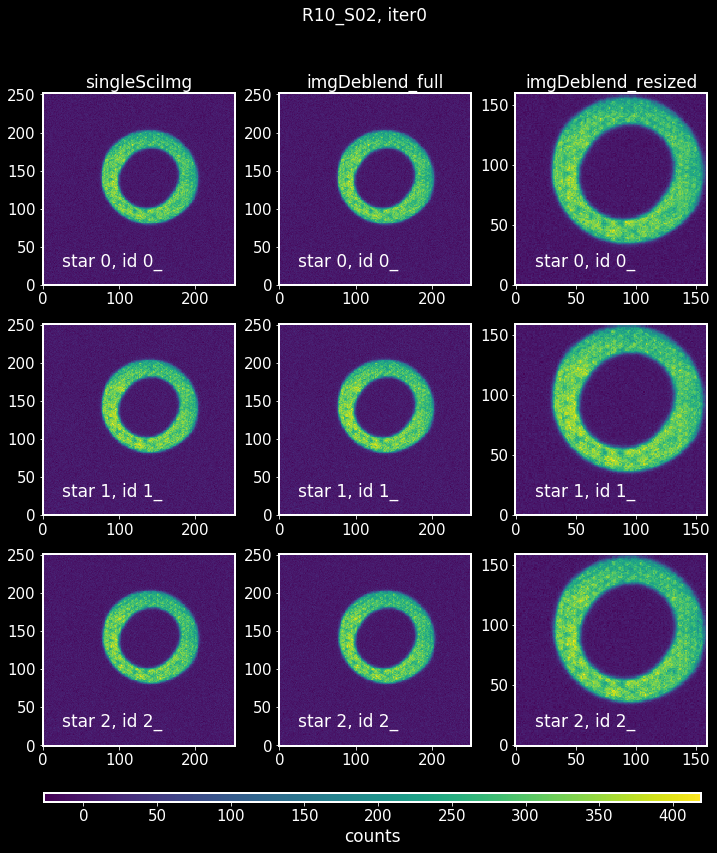

In [674]:
#for iterNum in range(2):# iterNum
sensor = 'R10_S02'
iterNum=0
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_image.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter1/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter1/postage directory

Available postage stamp images for sensor R10_S02: 

Looking for files that start with "extra_singleSciImg" and contain "R10_S02"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R10_S02_star-0_id-0_posX-3006_posY-3008.txt', 'extra_singleSciImg_sensor-R10_S02_star-1_id-1_posX-2007_posY-2009.txt', 'extra_singleSciImg_sensor-R10_S02_star-2_id-2_posX-1007_posY-1009.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R10_S02"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R10_S02_star-0_id-0_posX-3006_posY-3008.txt', 'extra_imgDeblend_full_sensor-R10_S02_star-1_id-1

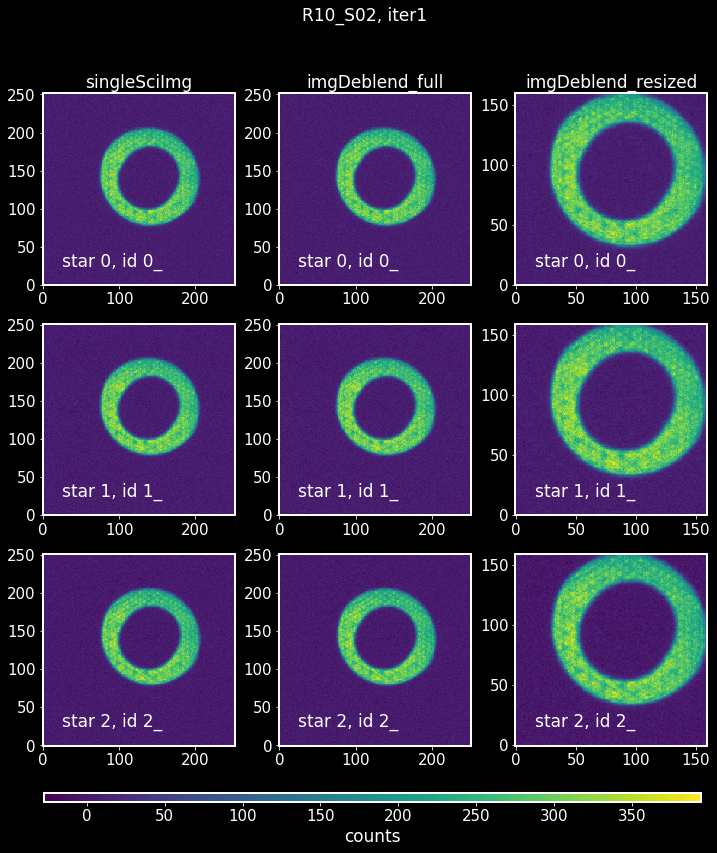

In [667]:
#for iterNum in range(2):# iterNum
sensor = 'R10_S02'
iterNum=1
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_image.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d'%(sensor,iterNum))

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter2/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/baselineTestLsstFamCam_R14_S00_image_4sensors/iter2/postage directory

Available postage stamp images for sensor R10_S02: 

Looking for files that start with "extra_singleSciImg" and contain "R10_S02"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R10_S02_star-0_id-0_posX-3006_posY-3008.txt', 'extra_singleSciImg_sensor-R10_S02_star-1_id-1_posX-2006_posY-2009.txt', 'extra_singleSciImg_sensor-R10_S02_star-2_id-2_posX-1007_posY-1009.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R10_S02"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R10_S02_star-0_id-0_posX-3006_posY-3008.txt', 'extra_imgDeblend_full_sensor-R10_S02_star-1_id-1

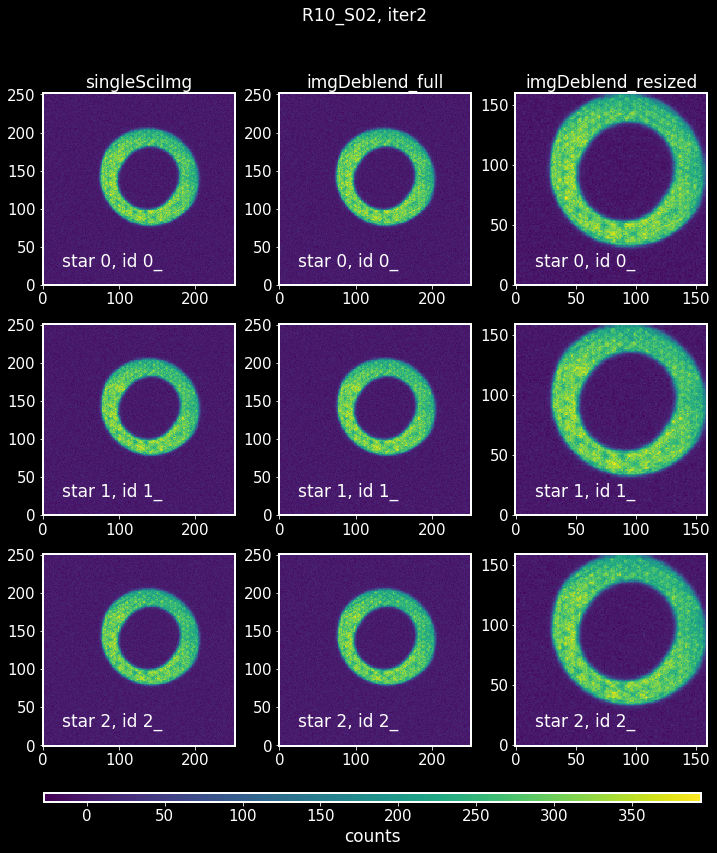

In [668]:
#for iterNum in range(2):# iterNum
sensor = 'R10_S02'
iterNum=2
at.plotPostageStamps(os.path.join(outputDir, 'iter%d'%iterNum,'postage'), sensor=sensor,
                    filename='AOS_postage_%s_iter%d_image.png'%(sensor,iterNum), 
                     suptitle='%s, iter%d'%(sensor,iterNum))

Saved fig as 1.png


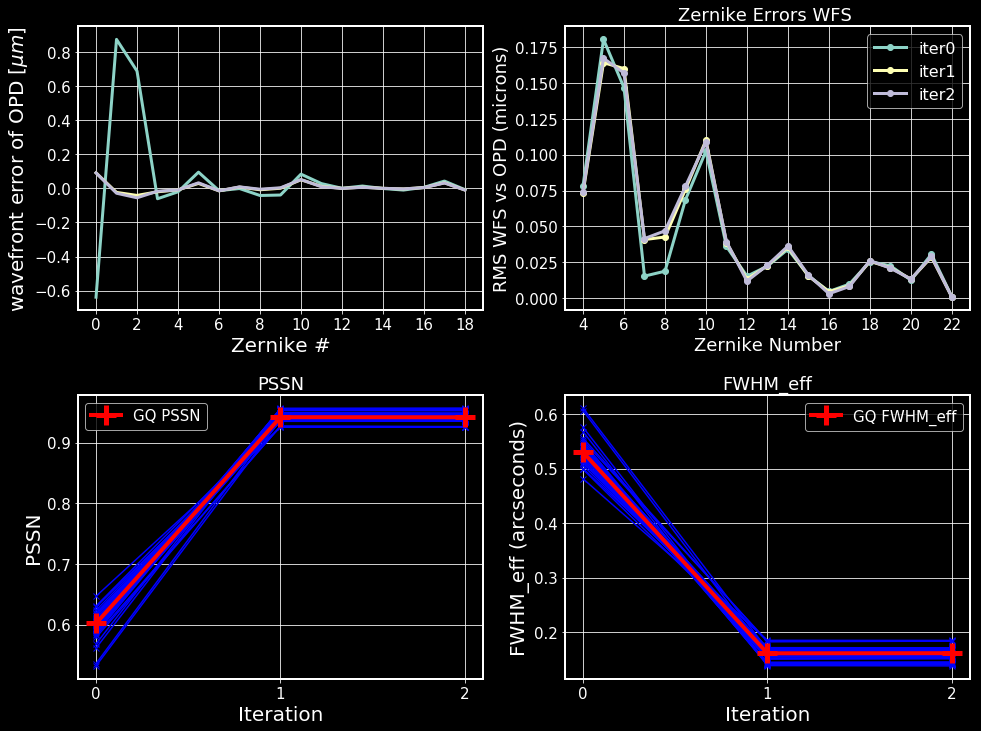

In [671]:
at.plotIterationSummary(outputDir,num_ccds=31,iterNum=3) 

# 2 a )  LsstCam baseline test : no background, no contam, 




- make code that generates a single star in the center of each half-sensor - that would be the quickest 
- then run LsstCam code through  tests that would show the convergence issues etc. 

In [706]:
import os
import argparse
import numpy as np

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
%matplotlib inline
import matplotlib.pyplot as plt 
plt.style.use('dark_background')

import sys
sys.path.append('../analysis_tools/')
import analysisTools as at

topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_noBkgnd_noContam_2_file_iters')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
opdCmdSettingsFile = 'opdDefault.cmd'
# I use that to match the beginning of the star cmd file below.
# this opdDefault.cmd has : 
# 
#         backgroundmode 0
#         raydensity 0.0
#         perturbationmode 1

starCmdSettingsFile = 'starDefault.cmd'
# starDefault.cmd   has  : 
# 
#         backgroundmode 0
#         raydensity 0.0
#         perturbationmode 1
#
#         trackingmode 0
#         cleartracking
#         clearclouds
#         lascatprob 0.0
#         contaminationmode 0  <-- no contam  ! 
#         diffractionmode 1
#         straylight 0
#         detectormode 0
#         centroidfile 1

selectSensors = 'lsstcam'
#skyFilePath = os.path.join(topDir, 'skyWfsArrow.txt')

bscDbType ='file'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --clobber --dbFileName bsc0.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefault.cmd --selectSensors lsstcam --clobber --dbFileName bsc0.db3 --bscDbType file


data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/input/rerun/run1
Done

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-198_posY-1001.txt', 'extra_singleSciImg_sensor-R00_S22_C1

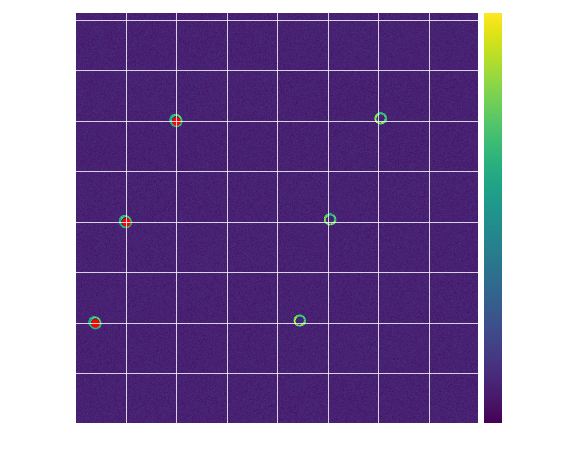

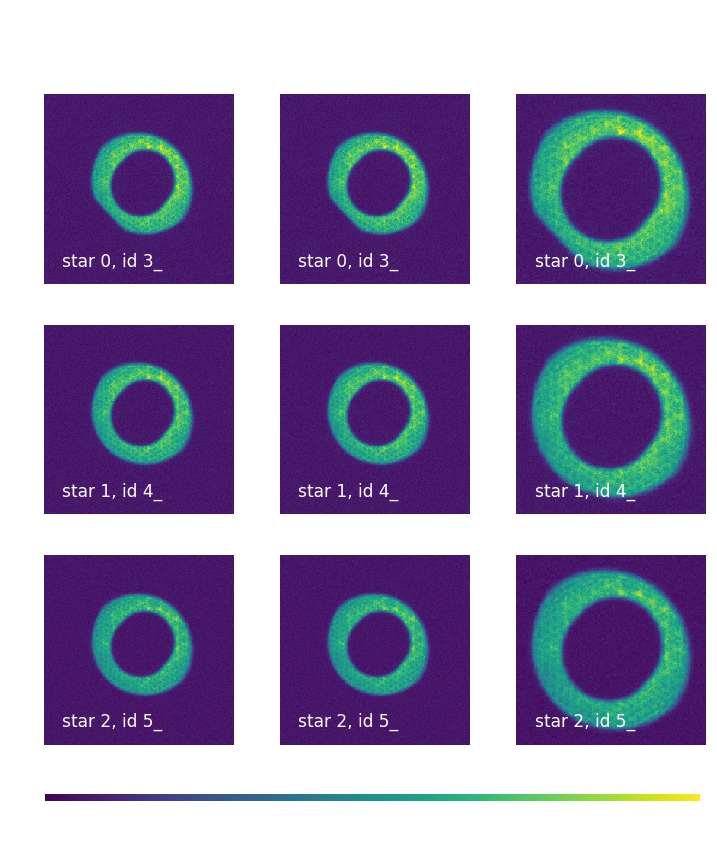

In [705]:
%matplotlib inline
image = at.readImage(outputDir,raft='R00',detector='S22', focalType='intra')
fig,ax = plt.subplots(1,1,figsize=(8,8))
at.plotImage(image, ax,plotArgs={'vmax':400})
ax.grid()
xPx = [200,500,1000]
yPx = [1000,2000,3000]
plt.scatter(xPx,yPx,s=55,c='r')

postageDir = os.path.join(outputDir, 'iter0/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-198_posY-1001.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-1_id-4_posX-497_posY-1999.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-2_id-5_posX-997_posY-3000.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R00_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R00_S22_C1_star-0_id-3_posX-198_posY-1001.txt', 'extra_

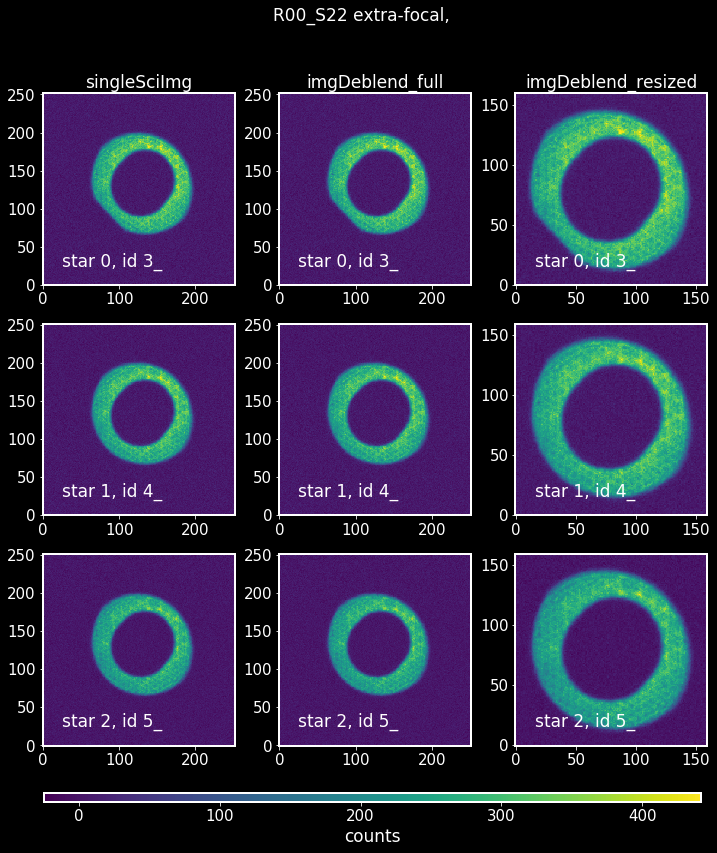

In [707]:
postageDir = os.path.join(outputDir, 'iter0/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter1/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter1/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-203_posY-1008.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-1_id-4_posX-502_posY-2006.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-2_id-5_posX-1002_posY-3007.txt']

Looking for files that start with "extra_imgDeblend_full" and contain "R00_S22"...

Found 3 imgDeblend_full postage stamp images 
['extra_imgDeblend_full_sensor-R00_S22_C1_star-0_id-3_posX-203_posY-1008.txt', 'extra

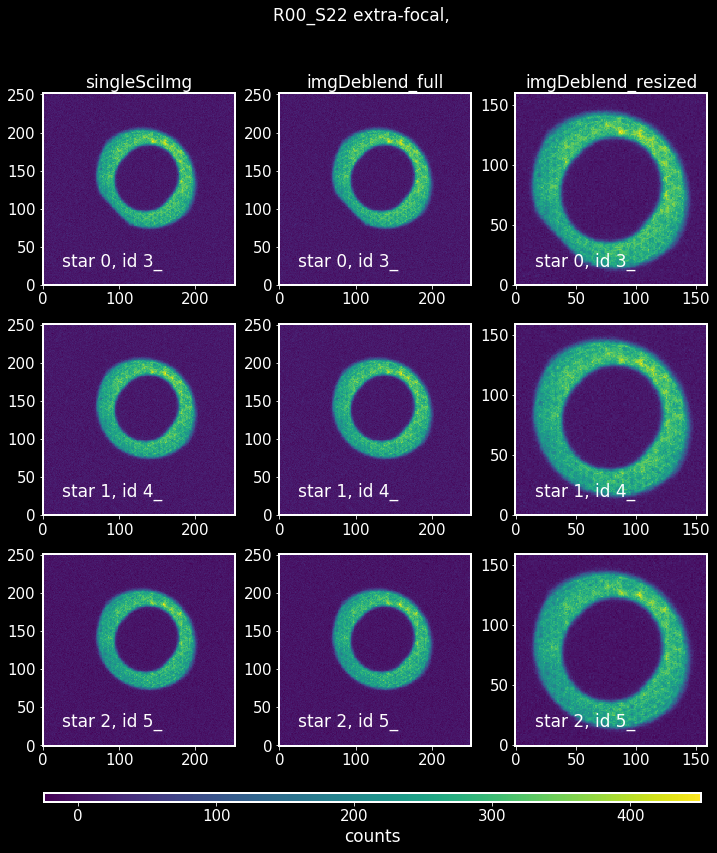

In [708]:
postageDir = os.path.join(outputDir, 'iter1/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

In [362]:
topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_noBkgnd_noContam_2_file_iters')

Saved fig as 1.png


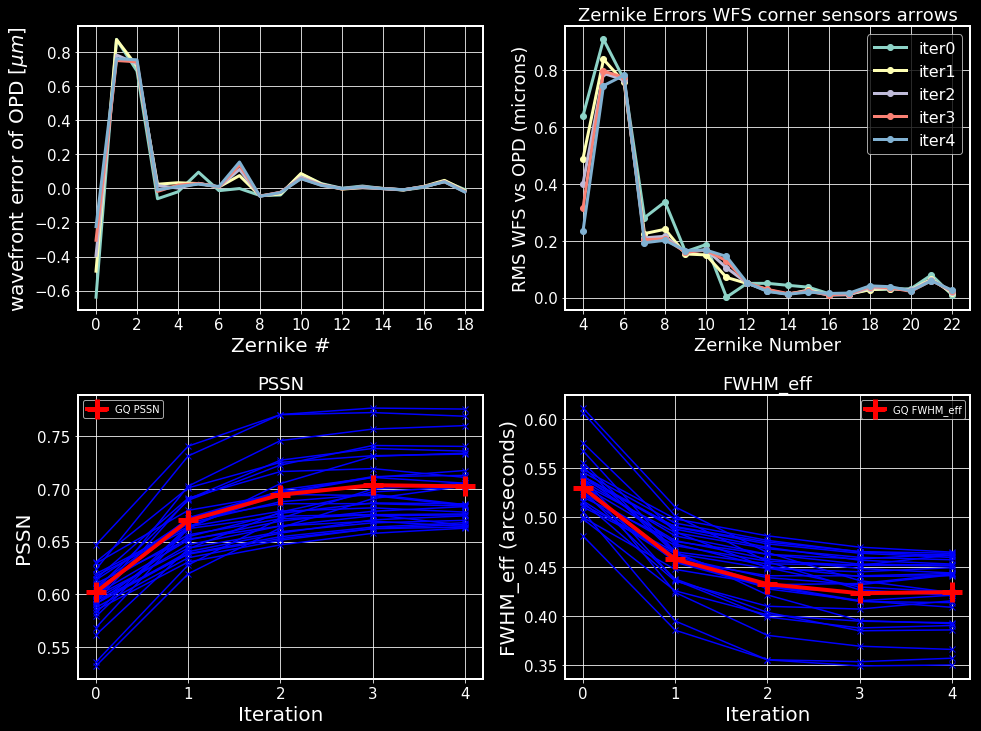

In [363]:
at.plotIterationSummary(outputDir, iterNum=5, num_ccds=31)

# 2 b )  LsstCam baseline test :  quickbackground, no contam, 



In [530]:
import os
import argparse
import numpy as np

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
%matplotlib inline
import matplotlib.pyplot as plt 
plt.style.use('dark_background')

import sys
sys.path.append('../analysis_tools/')
import analysisTools as at

topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_qckBkgnd_noContam_file_iters')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
opdCmdSettingsFile = 'opdQuickBackground.cmd'
# I use that to match the beginning of the star cmd file below.
# this opdDefault.cmd has : 
# 
#         quickbackground
#         raydensity 0.0
#         perturbationmode 1

starCmdSettingsFile = 'starQuickBackground.cmd'
# starDefault.cmd   has  : 
#         quickbackground
#         raydensity 0.0
#         perturbationmode 1
#
#         trackingmode 0
#         cleartracking
#         clearclouds
#         lascatprob 0.0
#         contaminationmode 0 <-- no contam 
#         diffractionmode 1
#         straylight 0
#         detectormode 0
#         centroidfile 1


selectSensors = 'lsstcam'


bscDbType ='file'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --clobber --dbFileName bsc.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_noContam_file_iters  --opdCmdSettingsFile opdQuickBackground.cmd --starCmdSettingsFile starQuickBackground.cmd --selectSensors lsstcam --clobber --dbFileName bsc.db3 --bscDbType file


data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_noContam_file_iters/input/rerun/run1
Done

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_noContam_file_iters/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_noContam_file_iters/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-217_posY-1014.txt', 'extra_singleSciImg_sensor-R00_S22_C1_st

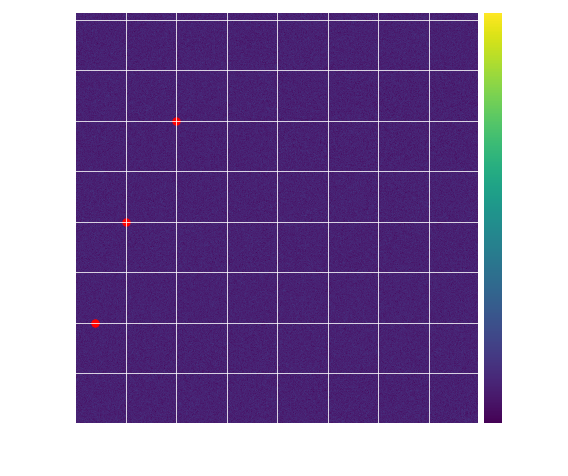

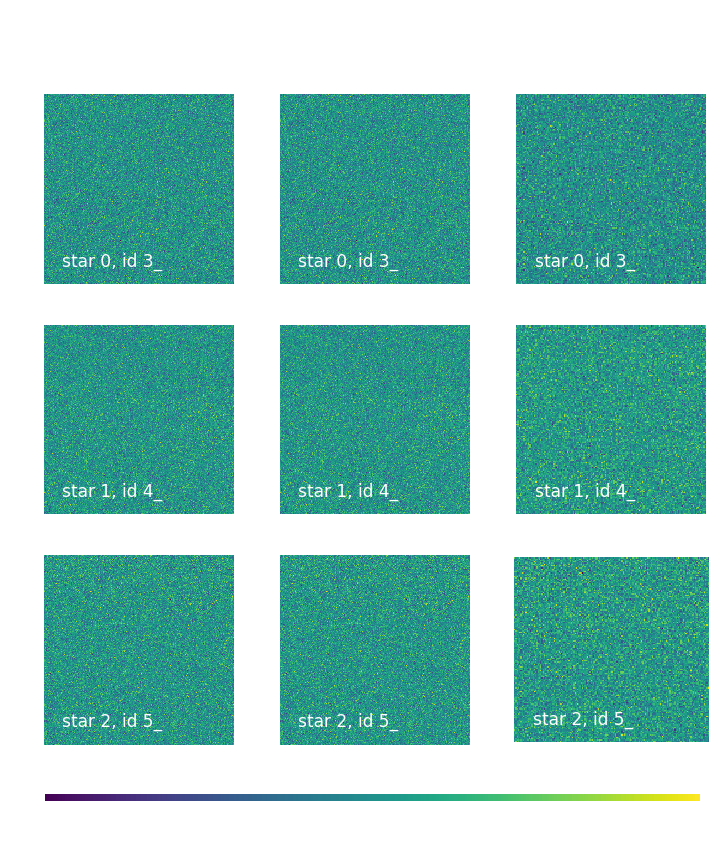

In [531]:
%matplotlib inline


image = at.readImage(outputDir,raft='R00',detector='S22', focalType='intra')
fig,ax = plt.subplots(1,1,figsize=(8,8))
at.plotImage(image, ax,plotArgs={'vmax':400})
ax.grid()
xPx = [200,500,1000]
yPx = [1000,2000,3000]
plt.scatter(xPx,yPx,s=55,c='r')

postageDir = os.path.join(outputDir, 'iter0/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

(array([4.255726e+06, 2.854263e+06, 1.138500e+06, 2.769370e+05,
        4.104400e+04, 4.154000e+03, 2.470000e+02, 8.000000e+00,
        0.000000e+00, 0.000000e+00]),
 array([ 0.,  5., 10., 15., 20., 25., 30., 35., 40., 45., 50.],
       dtype=float32),
 <a list of 10 Patch objects>)

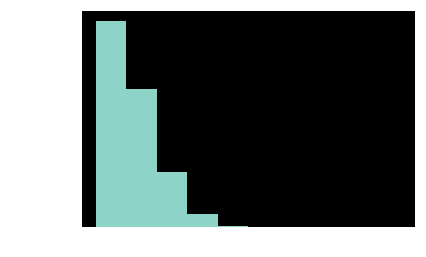

In [535]:
plt.hist(np.ravel(image),range=(0,50))

# 2c)  LsstCam baseline test :  quickbackground, contam,

In [366]:
import os
import argparse
import numpy as np

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
%matplotlib inline
import matplotlib.pyplot as plt 
plt.style.use('dark_background')

import sys
sys.path.append('../analysis_tools/')
import analysisTools as at

topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_qckBkgnd_Contam_file_iters')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
opdCmdSettingsFile = 'opdQuickBackground.cmd'
# I use that to match the beginning of the star cmd file below.
# this opdDefault.cmd has : 
# 
#         quickbackground
#         raydensity 0.0
#         perturbationmode 1

starCmdSettingsFile = 'starQuickBackgroundContam.cmd'
# starDefault.cmd   has  : 
#         quickbackground
#         raydensity 0.0
#         perturbationmode 1
#
#         trackingmode 0
#         cleartracking
#         clearclouds
#         lascatprob 0.0
#         contaminationmode 1 <-- with  contam 
#         diffractionmode 1
#         straylight 0
#         detectormode 0
#         centroidfile 1


selectSensors = 'lsstcam'
#skyFilePath = os.path.join(topDir, 'skyWfsArrow.txt')

bscDbType ='file'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --clobber --dbFileName bsc2.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_Contam_file_iters  --opdCmdSettingsFile opdQuickBackground.cmd --starCmdSettingsFile starQuickBackgroundContam.cmd --selectSensors lsstcam --clobber --dbFileName bsc2.db3 --bscDbType file


data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_Contam_file_iters/input/rerun/run1
Done

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_Contam_file_iters/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_qckBkgnd_Contam_file_iters/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-217_posY-1014.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-1_i

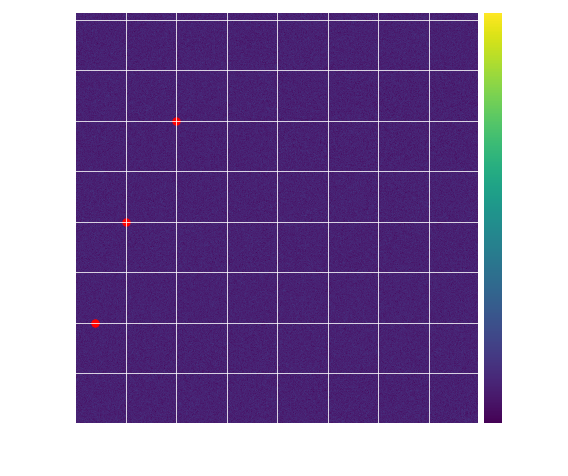

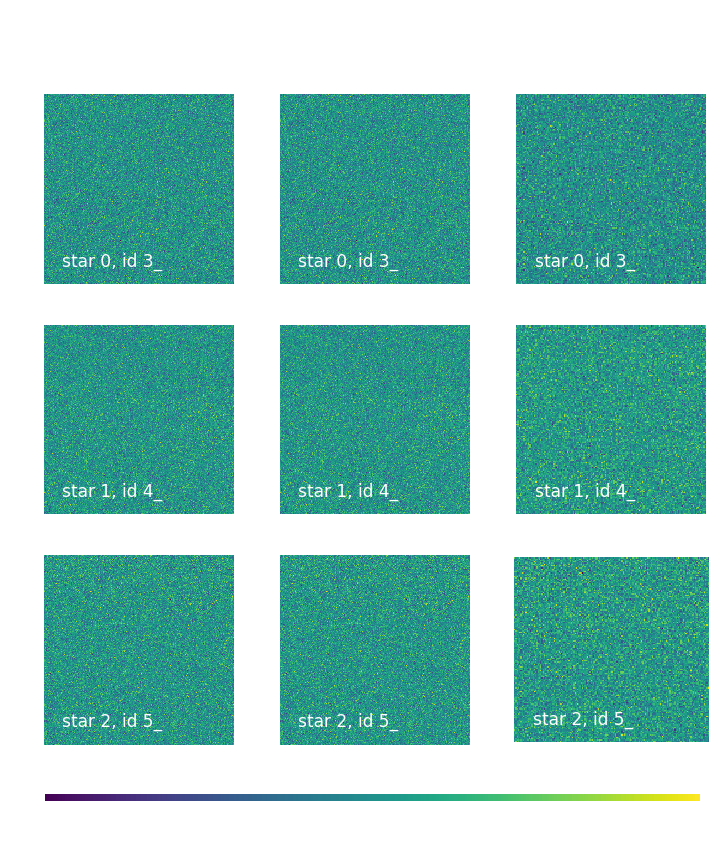

In [327]:
%matplotlib inline
image = at.readImage(outputDir,raft='R00',detector='S22', focalType='intra')
fig,ax = plt.subplots(1,1,figsize=(8,8))
at.plotImage(image, ax,plotArgs={'vmax':400})
ax.grid()
xPx = [200,500,1000]
yPx = [1000,2000,3000]
plt.scatter(xPx,yPx,s=55,c='r')

postageDir = os.path.join(outputDir, 'iter0/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

Saved fig as 1.png


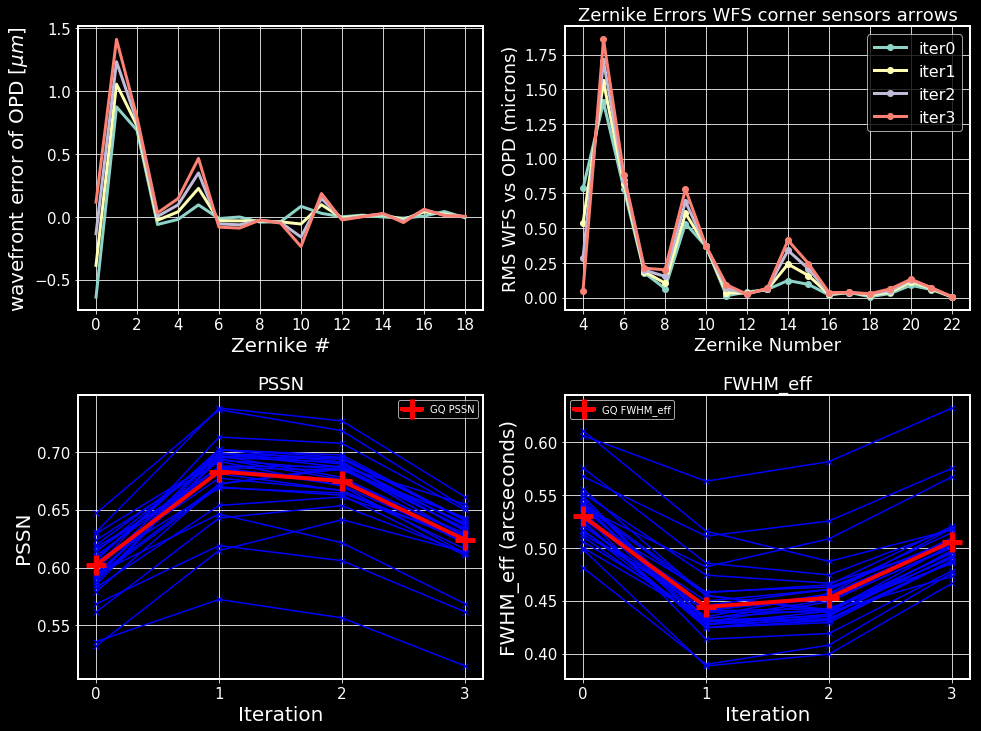

In [367]:
at.plotIterationSummary(outputDir, iterNum=4, num_ccds=31)


# 2d)  LsstCam baseline test :  backgroundmode 0, contam,

In [435]:
import os
import argparse
import numpy as np

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
%matplotlib inline
import matplotlib.pyplot as plt 
plt.style.use('dark_background')

import sys
sys.path.append('../analysis_tools/')
import analysisTools as at

topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_noBkgnd_Contam_file_iters')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
opdCmdSettingsFile = 'opdDefault.cmd'
# I use that to match the beginning of the star cmd file below.
# this opdDefault.cmd has : 
# 
#         backgroundmode 0
#         raydensity 0.0
#         perturbationmode 1

starCmdSettingsFile = 'starDefaultContam.cmd'
# starDefault.cmd   has  : 
# 
#         backgroundmode 0
#         raydensity 0.0
#         perturbationmode 1
#
#         trackingmode 0
#         cleartracking
#         clearclouds
#         lascatprob 0.0
#         contaminationmode 1  <-- with contam  ! the only difference between that and 2)a) 
#         diffractionmode 1
#         straylight 0
#         detectormode 0
#         centroidfile 1

selectSensors = 'lsstcam'
#skyFilePath = os.path.join(topDir, 'skyWfsArrow.txt')

bscDbType ='file'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --clobber --dbFileName bsc0.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_Contam_file_iters  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefaultContam.cmd --selectSensors lsstcam --clobber --dbFileName bsc0.db3 --bscDbType file


In [433]:
np.shape(image)

(4000, 4072)

data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_Contam_file_iters/input/rerun/run1
Done

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_Contam_file_iters/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_Contam_file_iters/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-198_posY-1001.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-1_id-4

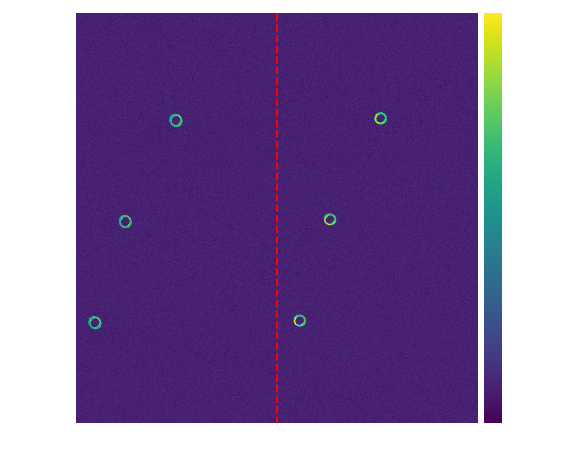

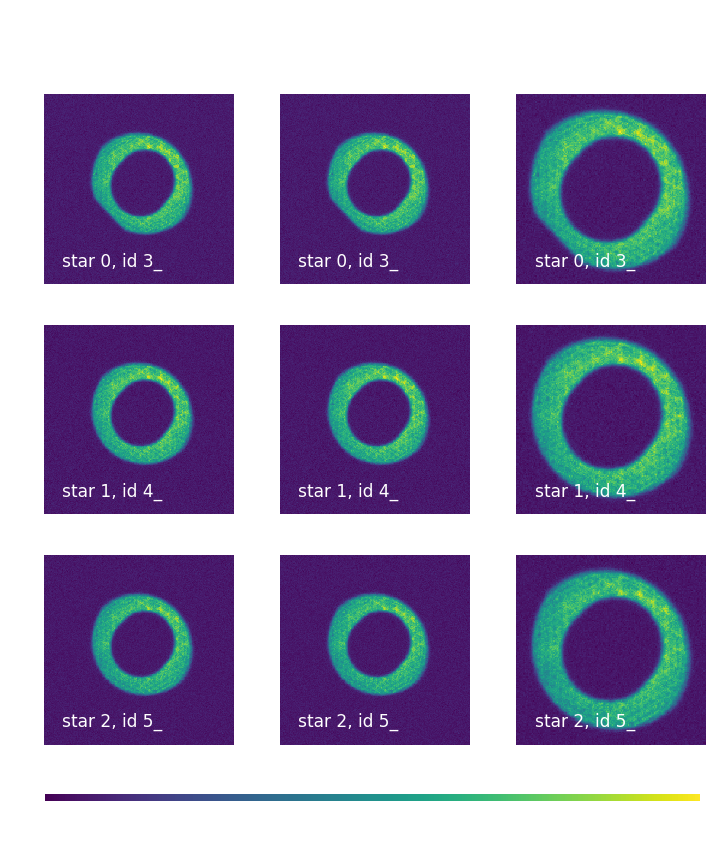

In [436]:
%matplotlib inline
image = at.readImage(outputDir,raft='R00',detector='S22', focalType='intra')
fig,ax = plt.subplots(1,1,figsize=(8,8))
at.plotImage(image, ax,plotArgs={'vmax':400})
#ax.grid()
ax.axvline(2000, ls='--', lw=2,c='r')
xPx = [200,500,1000]
yPx = [1000,2000,3000]
#plt.scatter(xPx,yPx,s=55,c='r')

postageDir = os.path.join(outputDir, 'iter0/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

Saved fig as 1.png


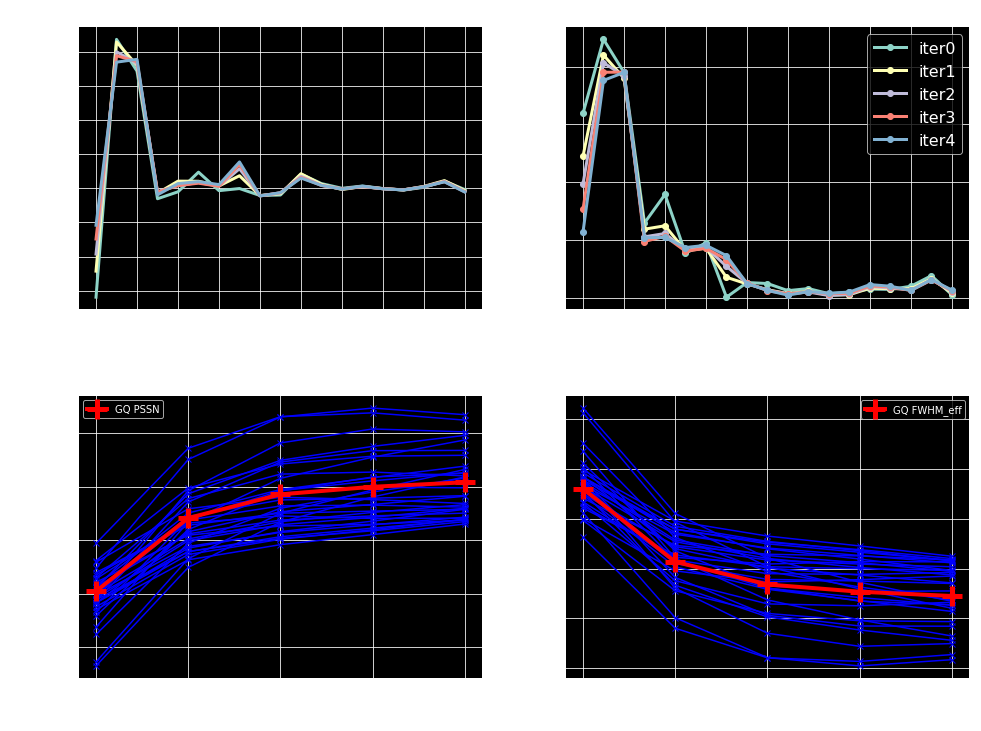

In [371]:
at.plotIterationSummary(outputDir, iterNum=5, num_ccds=31)


# 2e)  LsstCam baseline test :  backgroundmode 1, contamination mode 0

In [ ]:
import os
import argparse
import numpy as np

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
%matplotlib inline
import matplotlib.pyplot as plt 
plt.style.use('dark_background')

import sys
sys.path.append('../analysis_tools/')
import analysisTools as at

topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_Bkgnd_noContam_file_iters')

cmd = 'python baseAOSLoop.py'
numPro = 20
iterNum = 5
opdCmdSettingsFile = 'opdBackground.cmd'
# I use that to match the beginning of the star cmd file below.
# this opdDefault.cmd has : 
# 
#         normalbackground
#         raydensity 0.0
#         perturbationmode 1

starCmdSettingsFile = 'starBackground.cmd'
# starDefault.cmd   has  : 
# 
#         normalbackground
#         raydensity 0.0
#         perturbationmode 1
#
#         trackingmode 0
#         cleartracking
#         clearclouds
#         lascatprob 0.0
#         contaminationmode 0  <-- no contam  ! 
#         diffractionmode 1
#         straylight 0
#         detectormode 0
#         centroidfile 1

selectSensors = 'lsstcam'
#skyFilePath = os.path.join(topDir, 'skyWfsArrow.txt')

bscDbType ='file'
args = '--numPro %d --iterNum %d --outputDir %s \
 --opdCmdSettingsFile %s --starCmdSettingsFile %s \
--selectSensors %s --clobber --dbFileName bsc5.db3 --bscDbType %s'%(numPro, iterNum, outputDir,
            opdCmdSettingsFile, starCmdSettingsFile, selectSensors, bscDbType)
print('\n Run in terminal:')
print('%s %s'%(cmd,args))

data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_Bkgnd_noContam_file_iters/input/rerun/run1
Done

Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_Bkgnd_noContam_file_iters/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_Bkgnd_noContam_file_iters/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "extra_singleSciImg" and contain "R00_S22"...

Found 3 singleSciImg postage stamp images 
['extra_singleSciImg_sensor-R00_S22_C1_star-0_id-3_posX-217_posY-1014.txt', 'extra_singleSciImg_sensor-R00_S22_C1_star-1_id-4

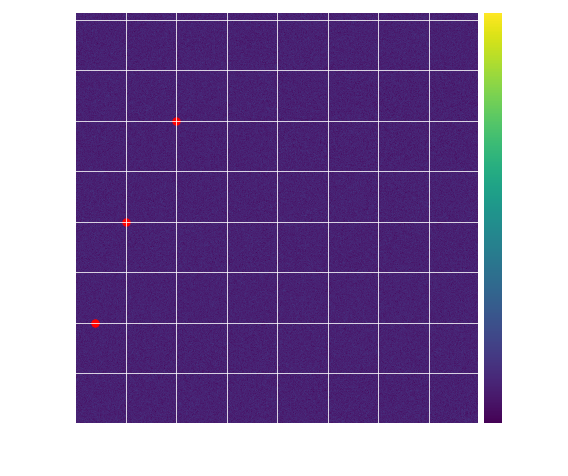

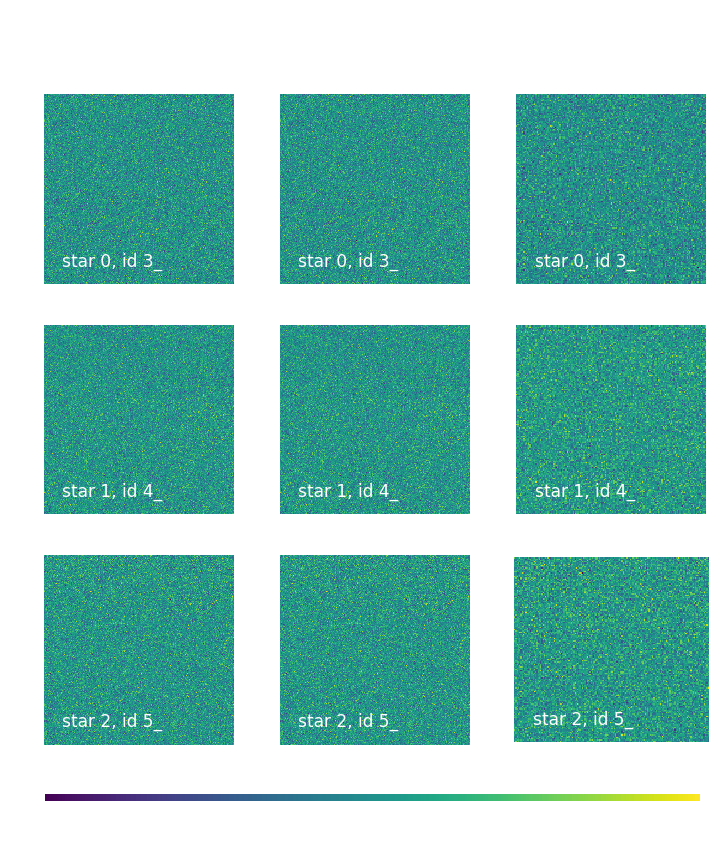

In [438]:
%matplotlib inline
image = at.readImage(outputDir,raft='R00',detector='S22', focalType='intra')
fig,ax = plt.subplots(1,1,figsize=(8,8))
at.plotImage(image, ax,plotArgs={'vmax':400})
ax.grid()
xPx = [200,500,1000]
yPx = [1000,2000,3000]
plt.scatter(xPx,yPx,s=55,c='r')

postageDir = os.path.join(outputDir, 'iter0/postage')
at.plotPostageStamps(postageDir, sensor='R00_S22')

In [440]:
np.max(image)

99993.84

(array([4.255726e+06, 2.854263e+06, 1.138500e+06, 2.769370e+05,
        4.104400e+04, 4.154000e+03, 2.470000e+02, 8.000000e+00,
        0.000000e+00, 0.000000e+00]),
 array([ 0.,  5., 10., 15., 20., 25., 30., 35., 40., 45., 50.],
       dtype=float32),
 <a list of 10 Patch objects>)

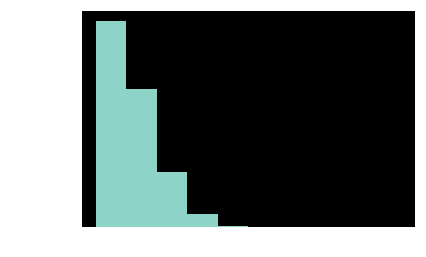

In [443]:
plt.hist(np.ravel(image),range=(0,50))

Saved fig as 1.png


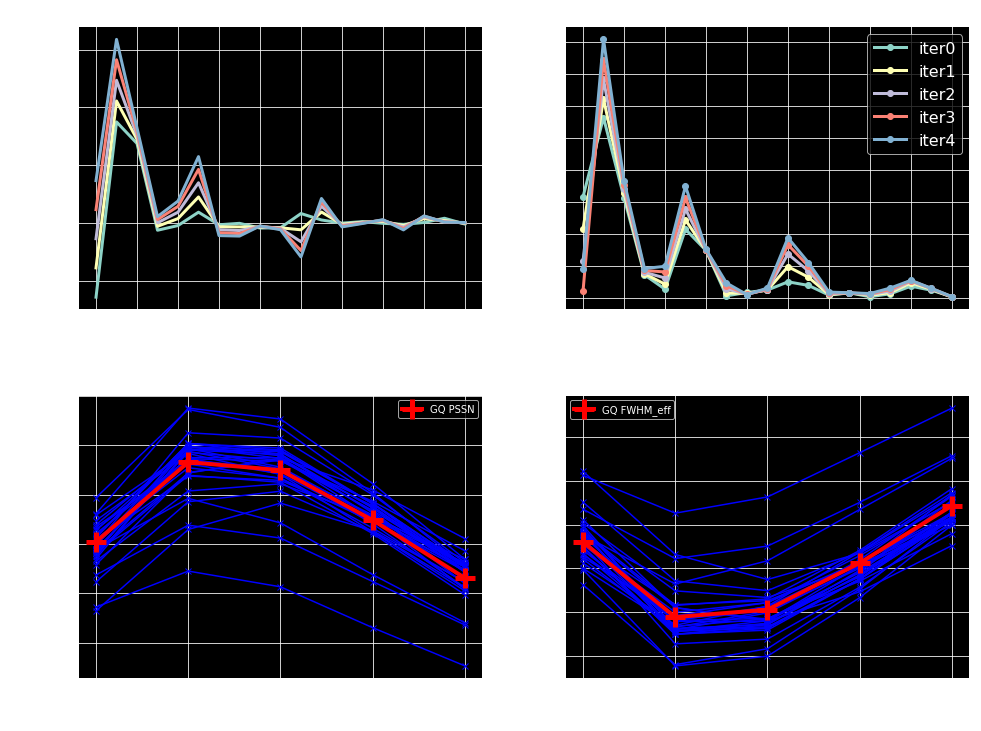

In [374]:
at.plotIterationSummary(outputDir, iterNum=5, num_ccds=31)


# 2f)  LsstCam baseline test :  backgroundmode 1, contamination mode 1

# 3 ) LsstCam : try to reproduce that with quickbackground  I don't get any stars... 

In [423]:
from lsst.utils import getPackageDir
from lsst.ts.phosim.Utility import getPhoSimPath
# 1) Use OPD cmd and inst files from baseline test :
phosimDir = getPhoSimPath()


path_to_ts_phosim = getPackageDir("ts_phosim")



#difference between no background and quickbackground ... 

# baselineTest_2020_24_noBkgnd_noContam_2_file_iters
workingDir1 = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs', 'background_test', 'noBkgnd')

sourceDir1  = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs','baselineTest_2020_24_noBkgnd_noContam_2_file_iters')


#baselineTest_2020_24_qckBkgnd_noContam_file_iters
workingDir2 = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs', 'background_test', 'qckBkgnd')
sourceDir2  = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs','baselineTest_2020_24_qckBkgnd_noContam_file_iters')
                          

for workingDir, sourceDir in zip([workingDir1, workingDir2], [sourceDir1, sourceDir2]):
    print('\n',workingDir, )
    print('\n',sourceDir, )

    pathToInstFile = os.path.join(sourceDir,'iter0/pert/starIntra.inst')
    pathToCmdFile = os.path.join(sourceDir,'iter0/pert/star.cmd')
    pathToOutputImg = workingDir
    pathToLogFile = os.path.join(workingDir,'starIntraPhoSim.log')
    
    # copy the inst and cmd files to workingDir 
    cmd = 'cp' 
    pathToSource  = os.path.join(sourceDir,'iter0/pert/')
    args = '%sstar* %s ' %(pathToSource, workingDir)
    print('\n Run in terminal:')
    print('%s %s'%(cmd,args))

    numPro = 15 
    
    # run phosim 
    cmd = 'python %sphosim.py'%phosimDir
    args = ' -w %s  %s -i lsst -e 1 -c %s -p %d -o %s > %s 2>&1' %  (
        workingDir , pathToInstFile, pathToCmdFile, numPro, 
        pathToOutputImg, pathToLogFile)



    print('\n Run in terminal:')
    print('%s %s'%(cmd,args))
    
    
    # Run the repackager ... 
    repackagedImgDir = os.path.join(workingDir, 'img/')
    if not os.path.exists(repackagedImgDir):
        os.makedirs(repackagedImgDir)

    command = "phosim_repackager.py"
    argstring = "%s --out_dir=%s" % (workingDir, repackagedImgDir)
    print('\n To repackage, run in terminal:')
    print(command, argstring)


 /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd

 /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters

 Run in terminal:
cp /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter0/pert/star* /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd 

 Run in terminal:
python /astro/store/epyc/projects/lsst_comm/phosim_syseng4/phosim.py  -w /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd  /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters/iter0/pert/starIntra.inst -i lsst -e 1

Show the resulting raw repackaged fits images: 

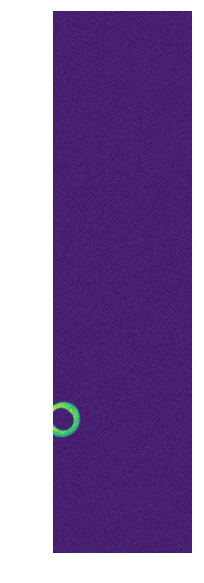

In [536]:
import astropy.io.fits as fits
fits_path = os.path.join('/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2/','img',
                        'lsst_a_9006002_f1_R00_S22_E000.fits')
# fits_path = os.path.join(path_to_ts_phosim, 'notebooks', 
#                           'analysis_scripts','results_wfs','baselineTest_2020_24_noBkgnd_noContam_2_file_iters',
#                         'iter0','img','intra','lsst_a_9006002_f1_R00_S22_E000.fits')
hdul = fits.open(fits_path)

img0 = hdul[4].data
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img0, origin='lower')

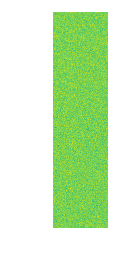

In [473]:
img0 = hdul[1].data
fig,ax = plt.subplots(1,1,)#figsize=(5,10))
ax.imshow(img0, origin='lower')

Try to use the inst and cmd files removing move and pert commands :

In [462]:
from lsst.utils import getPackageDir
from lsst.ts.phosim.Utility import getPhoSimPath
# 1) Use OPD cmd and inst files from baseline test :
phosimDir = getPhoSimPath()


path_to_ts_phosim = getPackageDir("ts_phosim")



#difference between no background and quickbackground ... 

# baselineTest_2020_24_noBkgnd_noContam_2_file_iters
workingDir1 = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs', 'background_test', 'noBkgnd2')


#baselineTest_2020_24_qckBkgnd_noContam_file_iters
workingDir2 = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs', 'background_test', 'qckBkgnd2')


# added a command "backdelta 1"
# to the end of the cmd file , adding "enter" after that (so that there is an empty line at teh end 
# of the cmd file )
workingDir3 = os.path.join(path_to_ts_phosim, 'notebooks', 
                          'analysis_scripts','results_wfs', 'background_test', 'qckBkgnd_comcam')

for workingDir in [workingDir1, workingDir2,workingDir3]:
    print('\n',workingDir, )


    pathToInstFile = os.path.join(workingDir,'starIntra.inst')
    pathToCmdFile = os.path.join(workingDir,'star.cmd')
    pathToOutputImg = workingDir
    pathToLogFile = os.path.join(workingDir,'starIntraPhoSim.log')

    numPro = 15 
    
    # run phosim 
    cmd = 'python %sphosim.py'%phosimDir
    args = ' -w %s  %s -i lsst -e 1 -c %s -p %d -o %s > %s 2>&1' %  (
        workingDir , pathToInstFile, pathToCmdFile, numPro, 
        pathToOutputImg, pathToLogFile)



    print('\n Run in terminal:')
    print('%s %s'%(cmd,args))
    
    
    # Run the repackager ... 
    repackagedImgDir = os.path.join(workingDir, 'img/')
    if not os.path.exists(repackagedImgDir):
        os.makedirs(repackagedImgDir)

    command = "phosim_repackager.py"
    argstring = "%s --out_dir=%s" % (workingDir, repackagedImgDir)
    print('\n To repackage, run in terminal:')
    print(command, argstring)


 /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2

 Run in terminal:
python /astro/store/epyc/projects/lsst_comm/phosim_syseng4/phosim.py  -w /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2  /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2/starIntra.inst -i lsst -e 1 -c /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2/star.cmd -p 15 -o /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2 > /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/background_test/noBkgnd2/starIntraPhoSim.log 2>&1

 To repackage, run in terminal:
phosim_repackager.py /astro/store/epyc/users/s

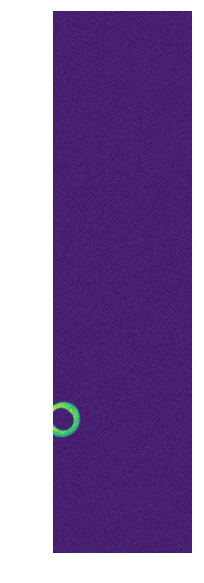

In [528]:
import astropy.io.fits as fits
fits_path = os.path.join(workingDir1,'img',
                        'lsst_a_9006002_f1_R00_S22_E000.fits')
# fits_path = os.path.join(path_to_ts_phosim, 'notebooks', 
#                           'analysis_scripts','results_wfs','baselineTest_2020_24_noBkgnd_noContam_2_file_iters',
#                         'iter0','img','intra','lsst_a_9006002_f1_R00_S22_E000.fits')
hdul = fits.open(fits_path)

img0 = hdul[4].data
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img0, origin='lower', )#vmin=1000,vmax=1500)

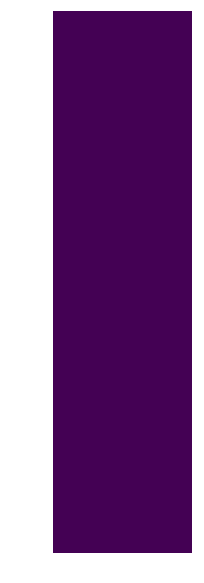

In [525]:
import astropy.io.fits as fits
fits_path = os.path.join(workingDir2,'img',
                         'lsst_a_9006002_f1_R00_S22_E000.fits')
#fits_path = os.path.join(workingDir2,'img',
#                        'lsst_a_9006002_f1_R44_S00_E000.fits')
# fits_path = os.path.join(path_to_ts_phosim, 'notebooks', 
#                           'analysis_scripts','results_wfs','baselineTest_2020_24_noBkgnd_noContam_2_file_iters',
#                         'iter0','img','intra','lsst_a_9006002_f1_R00_S22_E000.fits')
hdul = fits.open(fits_path)

img0 = hdul[4].data
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img0, origin='lower', vmin=1000,vmax=1500)

(array([0.00000e+00, 0.00000e+00, 2.09948e+05, 8.05169e+05, 6.80000e+02,
        6.81000e+02, 1.46800e+03, 5.40000e+01, 0.00000e+00, 0.00000e+00]),
 array([1000., 1050., 1100., 1150., 1200., 1250., 1300., 1350., 1400.,
        1450., 1500.]),
 <a list of 10 Patch objects>)

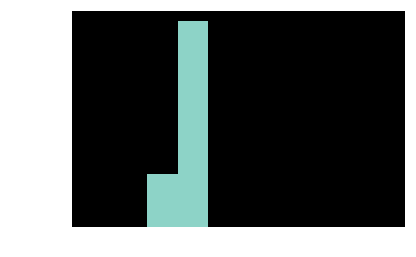

In [503]:
plt.hist(np.ravel(img0), range=(1000,1500))

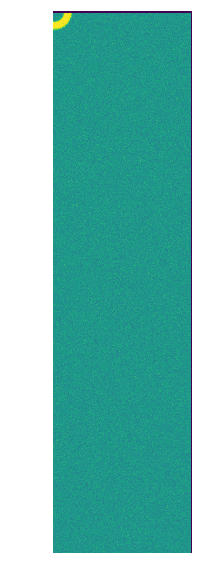

In [502]:
import astropy.io.fits as fits
fits_path = os.path.join(workingDir3,'img',
                        'lsst_a_9006002_f1_R22_S11_E000.fits')
# fits_path = os.path.join(path_to_ts_phosim, 'notebooks', 
#                           'analysis_scripts','results_wfs','baselineTest_2020_24_noBkgnd_noContam_2_file_iters',
#                         'iter0','img','intra','lsst_a_9006002_f1_R00_S22_E000.fits')
hdul = fits.open(fits_path)

img0 = hdul[4].data
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img0, origin='lower', vmin=1000, vmax=1300)

In [82]:
from lsst.ts.wep.SourceProcessor import SourceProcessor

In [83]:
_sourProc = SourceProcessor()
_sourProc.config('R00_S22_C0')

In [85]:
xInpixelInCam=1000
yInPixelInCam=1000
pixelDmX, pixelDmY = _sourProc.camXY2DmXY(xInpixelInCam,
                                                       yInPixelInCam)

In [88]:
from lsst.ts.wep.Utility import expandDetectorName

In [90]:
sensorName = 'R00_S22_C0'
expandedSensorName = expandDetectorName(sensorName)

In [91]:
expandedSensorName

'R:0,0 S:2,2,A'

How about arrows ? Were they put at the right locations at all ? 



In [227]:
outputDir = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/arrowStars_2020_24_noPert/'
imageArrow = at.readImage(outputDir,
                         raft='R00',detector='S22',focalType='intra')

data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/arrowStars_2020_24_noPert/input/rerun/run1
Done



[1500 1500 1500 1500] [1900 2200 2500 2800]
[ 400  700 1000 1300] [3000 3000 3000 3000]
y=1.00x 1500.00
[ 200  400  600  800 1000 1200 1400] [1700. 1900. 2100. 2300. 2500. 2700. 2900.]
[1500. 1500. 1500. 1500.  400.  700. 1000. 1300.  200.  400.  600.  800.
 1000. 1200. 1400. 1500.] [1900. 2200. 2500. 2800. 3000. 3000. 3000. 3000. 1700. 1900. 2100. 2300.
 2500. 2700. 2900. 3000.]


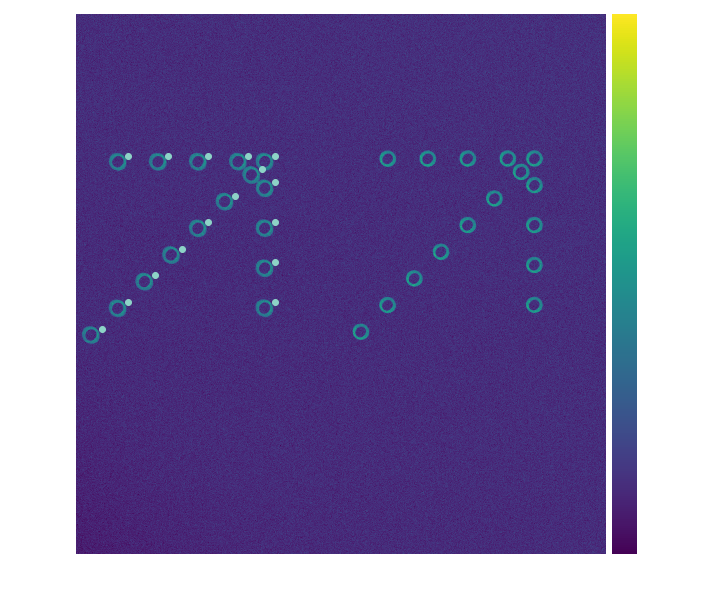

In [230]:
%matplotlib inline
fig,ax = plt.subplots(1,1,figsize=(10,10))
at.plotImage(imageArrow, ax, plotArgs={'vmax':1000})
xPx, yPx = at.pixel_arrow(x_vertex=1500, y_vertex=3000, width=1100, 
                spacing=300, diag_spacing=200, xmin=0, xmax=2000,
                ymin=0, ymax=4072, xy_offset=1300, print_shape=False )
ax.scatter(xPx,yPx)

Catalog that was used as source : 

In [233]:
from astropy.table import Table
d1 = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/' 
d2 = 'results_wfs'
outputDir = os.path.join(d1,d2)
outputSkyFilePath = os.path.join(outputDir, "skyWfsArrow.txt")
stars = Table.read(outputSkyFilePath, format='ascii')


Make the same stars now - do the coords agree 

[1500 1500 1500 1500] [1900 2200 2500 2800]
[ 400  700 1000 1300] [3000 3000 3000 3000]
y=1.00x 1500.00
[ 200  400  600  800 1000 1200 1400] [1700. 1900. 2100. 2300. 2500. 2700. 2900.]
[1500. 1500. 1500. 1500.  400.  700. 1000. 1300.  200.  400.  600.  800.
 1000. 1200. 1400. 1500.] [1900. 2200. 2500. 2800. 3000. 3000. 3000. 3000. 1700. 1900. 2100. 2300.
 2500. 2700. 2900. 3000.]


In [271]:
skySim = SkySim()
skySim.setObservationMetaData(0,0,0, 59500)

xPx, yPx = at.pixel_arrow(x_vertex=1500, y_vertex=3000, width=1100, 
                spacing=300, diag_spacing=200, xmin=0, xmax=2000,
                ymin=0, ymax=4072, xy_offset=1300, print_shape=False )
sensorName = ["R44_S00_C0", "R00_S22_C1", "R44_S00_C1", "R00_S22_C0",
              "R04_S20_C1", "R40_S02_C0", "R04_S20_C0", "R40_S02_C1"]
starMag = 15
starId = 0
for sensor in sensorName:
    for ii in range(len(xPx)):
        skySim.addStarByChipPos(sensor, starId, xPx[ii],
                                yPx[ii], starMag)
        starId += 1
        
# Export sky information
d1 = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/' 
d2 = 'results_wfs'
outputDir = os.path.join(d1,d2)
outputSkyFilePath = os.path.join(outputDir, "arrowsTest.txt")
skySim.exportSkyToFile(outputSkyFilePath)
starsTest = Table.read(outputSkyFilePath, format='ascii')

[1500 1500 1500 1500] [1900 2200 2500 2800]
[ 400  700 1000 1300] [3000 3000 3000 3000]
y=1.00x 1500.00
[ 200  400  600  800 1000 1200 1400] [1700. 1900. 2100. 2300. 2500. 2700. 2900.]
[1500. 1500. 1500. 1500.  400.  700. 1000. 1300.  200.  400.  600.  800.
 1000. 1200. 1400. 1500.] [1900. 2200. 2500. 2800. 3000. 3000. 3000. 3000. 1700. 1900. 2100. 2300.
 2500. 2700. 2900. 3000.]


Get the sensor boundaries as ts_wep does: 

In [276]:
from lsst.ts.wep.Utility import CamType
from lsst.ts.wep.ctrlIntf.WEPCalculationFactory import WEPCalculationFactory

wep_calc = WEPCalculationFactory.getCalculator(CamType.LsstCam, closed_loop_input_dir)
sourSelc = wep_calc.wepCntlr.getSourSelc()



Using mjd=50000, c=r


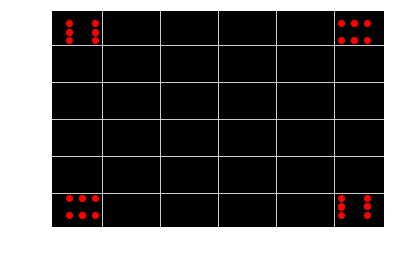

In [293]:
%matplotlib inline

fig,ax = plt.subplots(1,1,)
#thes coords are center of each sensor 
raInDeg = 0 ; decInDeg = 0 ; rotSkyPos = 0 
for mjd,c in zip([50000],['r']):
    print('\nUsing mjd=%d, c=%s'%(mjd,c))
    sourSelc.camera.setObsMetaData(raInDeg,decInDeg,rotSkyPos, mjd)
    wavefrontSensors= sourSelc.camera.getWavefrontSensor()
    for detector, wavefrontSensor in wavefrontSensors.items():
        #print(detector)#, wavefrontSensor)  

        corner1 = wavefrontSensor[0]
        corner2 = wavefrontSensor[1]
        corner3 = wavefrontSensor[2]
        corner4 = wavefrontSensor[3]
        ra = np.array([corner1[0], corner2[0], corner3[0], corner4[0]])
        decl = np.array([corner1[1], corner2[1], corner3[1], corner4[1]])

        # switch from (0,360) to (-180,180) 
        # just for plotting 
        m = ra>180
        ra[m] = ra[m] - 360
        #print(ra)
        #print(decl)
        ax.scatter(ra,decl,c=c)
    ax.set_xlabel('Ra [deg]')
    ax.set_xlabel('Decl [deg]')
    ax.grid()



[(1.0651294214780593, 1.2886201020015078),
 (1.1760378760949977, 1.2885547454271253),
 (1.0653045310009759, 1.0628341088322768),
 (1.1762290918698313, 1.062792699505355)]

R:0,0 S:2,2,A
[1500 1500 1500 1500] [1900 2200 2500 2800]
[ 400  700 1000 1300] [3000 3000 3000 3000]
y=1.00x 1500.00
[ 200  400  600  800 1000 1200 1400] [1700. 1900. 2100. 2300. 2500. 2700. 2900.]
[1500. 1500. 1500. 1500.  400.  700. 1000. 1300.  200.  400.  600.  800.
 1000. 1200. 1400. 1500.] [1900. 2200. 2500. 2800. 3000. 3000. 3000. 3000. 1700. 1900. 2100. 2300.
 2500. 2700. 2900. 3000.]
[1500 1500 1500 1500] [1900 2200 2500 2800]
[ 400  700 1000 1300] [3000 3000 3000 3000]
y=1.00x 1500.00
[ 200  400  600  800 1000 1200 1400] [1700. 1900. 2100. 2300. 2500. 2700. 2900.]
[1500. 1500. 1500. 1500.  400.  700. 1000. 1300.  200.  400.  600.  800.
 1000. 1200. 1400. 1500.] [1900. 2200. 2500. 2800. 3000. 3000. 3000. 3000. 1700. 1900. 2100. 2300.
 2500. 2700. 2900. 3000.]


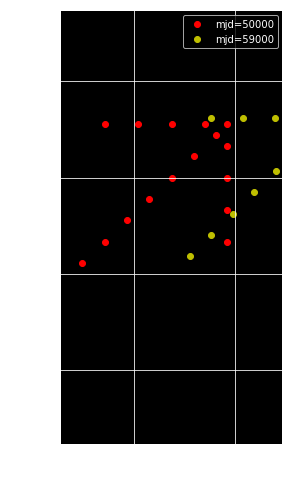

In [330]:
%matplotlib inline
wavefrontSensors= sourSelc.camera.getWavefrontSensor()
detectors = list(wavefrontSensors.keys())

detector = detectors[0]
print(detector)
wavefrontSensor = wavefrontSensors[detector]
corner1 = wavefrontSensor[0]
corner2 = wavefrontSensor[1]
corner3 = wavefrontSensor[2]
corner4 = wavefrontSensor[3]
ra = np.array([corner1[0], corner2[0], corner3[0], corner4[0]])
decl = np.array([corner1[1], corner2[1], corner3[1], corner4[1]])

fig,ax  = plt.subplots(1,1,figsize=(4,8))

# simulate two different MJDs ... 
for mjd,c in zip([50000,59000], ['r','y']):
    skySim = SkySim()
    skySim.setObservationMetaData(0,0,0, mjd)

    xPx, yPx = at.pixel_arrow(x_vertex=1500, y_vertex=3000, width=1100, 
                    spacing=300, diag_spacing=200, xmin=0, xmax=2000,
                    ymin=0, ymax=4072, xy_offset=1300, print_shape=False )
    sensorName = ["R44_S00_C0", "R00_S22_C1", "R44_S00_C1", "R00_S22_C0",
                  "R04_S20_C1", "R40_S02_C0", "R04_S20_C0", "R40_S02_C1"]
    starMag = 15
    starId = 0
    for sensor in sensorName:
        for ii in range(len(xPx)):
            skySim.addStarByChipPos(sensor, starId, xPx[ii],
                                    yPx[ii], starMag)
            starId += 1

    # Export sky information
    d1 = '/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/' 
    d2 = 'results_wfs'
    outputDir = os.path.join(d1,d2)
    outputSkyFilePath = os.path.join(outputDir, "arrowsTest_%d.txt"%mjd)
    skySim.exportSkyToFile(outputSkyFilePath)
    
    # Read the saved sky file 
    starsTest = Table.read(outputSkyFilePath, format='ascii')

    # plot the contents 
    
    #ax.scatter(stars['Ra'], stars['Decl'], )
    ax.scatter(starsTest['Ra'], starsTest['Decl'], c=c, label='mjd=%d'%mjd)
    
ax.set_xlim(min(ra),max(ra))
ax.set_ylim(min(decl),max(decl))
ax.grid()
ax.legend(fontsize=17)

That's a big difference! Need to ensure that wherever the stars are made, it's the same that `ts_wep` gets initialized with !  (The boundaries above are for mjd=50000) m

In [29]:
from astropy.time import Time

In [37]:
a = Time([59000], format='mjd')

In [38]:
a.datetime

array([datetime.datetime(2020, 5, 31, 0, 0)], dtype=object)

In [92]:
getAoclcOutputPath()

NameError: name 'getAoclcOutputPath' is not defined

In [93]:
from lsst.ts.phosim.Utility import getConfigDir, getPhoSimPath, \
    getAoclcOutputPath

Text(0, 0.5, 'Y [px]')

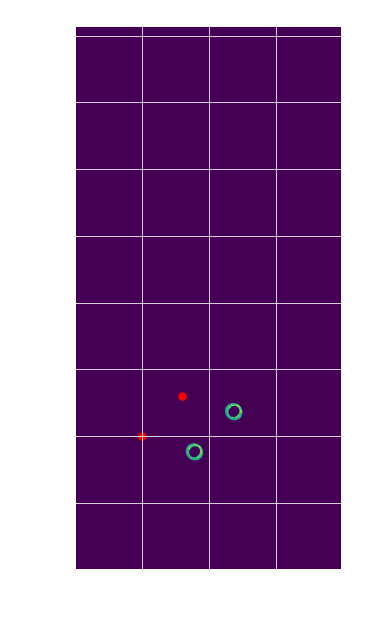

In [144]:
import astropy.io.fits as fits
#outputDir = getAoclcOutputPath()
outputDir= '/epyc/users/suberlak/Commissioning/aos/aoclc_output_0/'
fits_path = os.path.join(outputDir,'img/',
                        'lsst_e_9006000_f1_R00_S22_C0_E000.fits.gz')
hdul = fits.open(fits_path)
img0 = hdul[0].data
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img0, origin='lower')
ax.grid()
xInpixelInCam = [500, 800]
yInPixelInCam = [1000, 1300]
ax.scatter(xInpixelInCam,yInPixelInCam, c='r',s=55)   
ax.set_title('R00_S22_C0')
ax.set_xlabel('X [px]')
ax.set_ylabel('Y [px]')

In [263]:
from lsst.sims.utils import ObservationMetaData
from lsst.sims.coordUtils.CameraUtils import raDecFromPixelCoords
from lsst.sims.coordUtils import raDecFromPixelCoordsLSST
from lsst.obs.lsstSim import LsstSimMapper

_sourProc = SourceProcessor()
sensorName = 'R00_S22_C0'
_sourProc.config(sensorName=sensorName)

xInpixelInCam = 500
yInPixelInCam = 1000
pixelDmX, pixelDmY = _sourProc.camXY2DmXY(xInpixelInCam,
                                          yInPixelInCam)

# Expand the sensor name
expandedSensorName = expandDetectorName(sensorName)

# this doesn't change if I set mjd =  which corresponds to the year 2000.0,
# which is the default epoch
_obs = ObservationMetaData(pointingRA=0, pointingDec=0,
                                        rotSkyPos=0,
                                        mjd=59000)


raInDeg, declInDeg = raDecFromPixelCoords(
    pixelDmX, pixelDmY, expandedSensorName, camera=LsstSimMapper().camera,
    obs_metadata=_obs, epoch=2000,
    includeDistortion=True)

# # that's an alternative function but it doesn't make a difference ... 
# raInDeg_1, declInDeg_1 = raDecFromPixelCoordsLSST(
#     pixelDmX, pixelDmY, expandedSensorName,
#     obs_metadata=_obs, epoch=2000,
#     includeDistortion=True)


In [264]:
3600 * np.abs(raInDeg_1-raInDeg)

1.3694519177533948

In [265]:
3600 * np.abs(declInDeg_1-declInDeg)

1.3923649495541035

In [133]:
declInDeg

-1.2297288753183395

In [134]:
declInDeg_1

-1.2301156433598823

In [141]:
expandedSensorName.endswith(('A','B'))

True

check the image after the change: 

Text(0, 0.5, 'Y [px]')

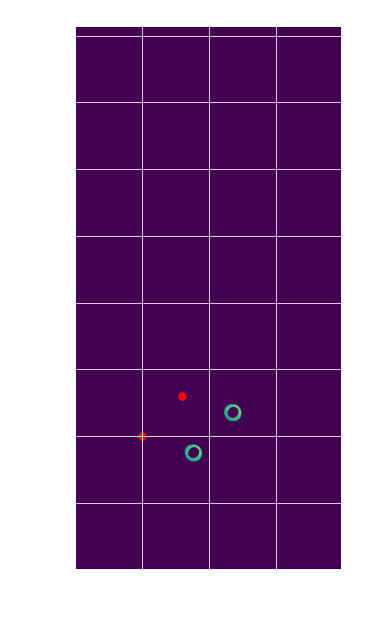

In [145]:
import astropy.io.fits as fits
outputDir = '/epyc/users/suberlak/Commissioning/aos/aoclc_output/'
fits_path = os.path.join(outputDir,'img/',
                        'lsst_e_9006000_f1_R00_S22_C0_E000.fits.gz')
hdul = fits.open(fits_path)
img1 = hdul[0].data
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img1, origin='lower')
ax.grid()
xInpixelInCam = [500, 800]
yInPixelInCam = [1000, 1300]
ax.scatter(xInpixelInCam,yInPixelInCam, c='r',s=55)   
ax.set_title('R00_S22_C0')
ax.set_xlabel('X [px]')
ax.set_ylabel('Y [px]')

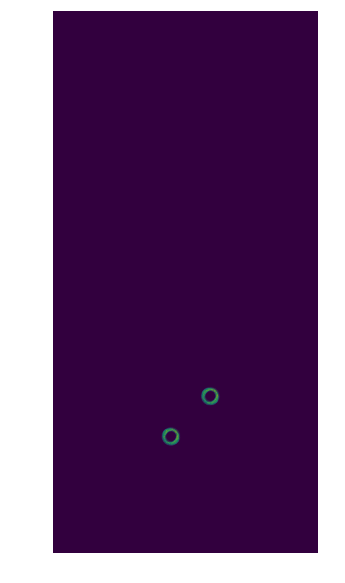

In [159]:
fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.imshow(img0, origin='lower',alpha=0.5)
ax.imshow(img1,origin='lower',alpha=0.5)

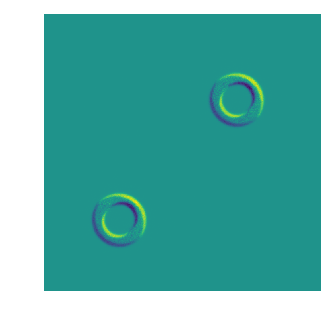

In [166]:
fig,ax = plt.subplots(1,1,figsize=(5,10))
diff = img0-img1
ax.imshow(diff[700:1400, 700:1400], origin='lower')


## Try running with bscDbType : image , if providing location of donuts by file is  not a good idea ... 


 Run in terminal:
python baseAOSLoop.py --numPro 20 --iterNum 5 --outputDir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2_file_iters  --opdCmdSettingsFile opdDefault.cmd --starCmdSettingsFile starDefault.cmd --selectSensors lsstcam --clobber --dbFileName bsc0.db3 --bscDbType file


# Digging into LocalDatabaseFromImage.py

Just run the postISR part : 

In [232]:
from lsst.ts.wep.ParamReader import ParamReader
path_to_ts_wep = '/epyc/users/suberlak/Commissioning/aos/ts_wep/'
bscDataDir = os.path.join(path_to_ts_wep, 'tests/testData')
dbFileName = 'bsc.db3'
if dbFileName  in os.listdir(bscDataDir):
    os.remove(os.path.join(bscDataDir,dbFileName))
    print('Removed old %s file'%dbFileName)

settingFilePath = os.path.join(path_to_ts_wep, 'policy/default.yaml')
settingFile = ParamReader(filePath=settingFilePath)
print('Before change, defaultBscPath: %s'%settingFile.getSetting("defaultBscPath"))

dbRelativePath = 'tests/testData/%s'%dbFileName
settingFile.updateSetting("defaultBscPath", dbRelativePath)
print('After change, defaultBscPath: %s'%settingFile.getSetting("defaultBscPath"))


path_to_ts_wep = '/epyc/users/suberlak/Commissioning/aos/ts_wep/'

# what bscDbType do we want to use ? 
bscDbType = 'image'

settingFilePath = os.path.join(path_to_ts_wep, 'policy/default.yaml')
settingFile = ParamReader(filePath=settingFilePath)
print('Before change: ', settingFile.getSetting("bscDbType"))


# In the following we update the setting for bscDbType saving the change in the default.yaml file 
settingFile.updateSetting("bscDbType", bscDbType)
settingFile.saveSetting(filePath=settingFilePath)

# check that the change indeed took place 
settingFilePath = os.path.join(path_to_ts_wep, 'policy/default.yaml')
settingFile = ParamReader(filePath=settingFilePath)
print('After change: ', settingFile.getSetting("bscDbType"))

Removed old bsc.db3 file
Before change, defaultBscPath: tests/testData/bsc.db3
After change, defaultBscPath: tests/testData/bsc.db3
Before change:  image
After change:  image


In [237]:
import sys
#del sys.modules['lsst.ts.wep.WepController']
#del sys.modules['lsst.ts.wep.ctrlIntf.WEPCalculationFactory']
#del sys.modules['lsst.ts.wep.Utility']
del sys.modules['lsst.ts.wep.bsc.DonutDetector']
#del sys.modules['lsst.ts.wep.bsc.LocalDatabaseFromImage']
from lsst.ts.wep.WepController import WepController
from lsst.ts.wep.ctrlIntf.WEPCalculationFactory import WEPCalculationFactory

# mostly from runCloseLoopPostISR.py 
from lsst.ts.wep.Utility import CamType, FilterType, getModulePath, mapFilterRefToG, DefocalType
closed_loop_input_dir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/input/'
print('Using %s '%closed_loop_input_dir )
# these are basically parts of WEPCalculationFactory.py  calculateWavefrontErrors()
# skipping the ingest and ISR 
wep_calc = WEPCalculationFactory.getCalculator(CamType.LsstCam, closed_loop_input_dir)
wep_calc.wepCntlr.setPostIsrCcdInputs(os.path.join(closed_loop_input_dir, 'rerun/run1'))

wep_calc.setBoresight(0,0)
wep_calc.setRotAng(0)
        
obsIdList = [9006002]

neighborStarMap = wep_calc._getTargetStar(obsIdList, defocalState=DefocalType.Intra)
detector_list = list(neighborStarMap)

Using /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/input/ 
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R04', 'detectorName': 'S20'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R40', 'detectorName': 'S02'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R44', 'detectorName': 'S00'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R04', 'detectorName': 'S20'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R40', 'detectorName': 'S02'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R44', 'detectorName': 'S00'}


['R:0,0 S:2,2,A',
 'R:0,4 S:2,0,A',
 'R:4,0 S:0,2,A',
 'R:4,4 S:0,0,A',
 'R:0,4 S:2,0,B',
 'R:4,4 S:0,0,B']

In [83]:


# Inside WEPCalculation.py  _getTargetStar()

visitList = obsIdList
defocalState=DefocalType.Intra

import os
import warnings

from lsst.ts.wep.Utility import getModulePath, getConfigDir, BscDbType, \
    FilterType, abbrevDetectorName, getBscDbType, getImageType, \
    getCentroidFindType, ImageType, DefocalType
from lsst.ts.wep.CamDataCollector import CamDataCollector
from lsst.ts.wep.CamIsrWrapper import CamIsrWrapper
from lsst.ts.wep.SourceProcessor import SourceProcessor
from lsst.ts.wep.SourceSelector import SourceSelector
from lsst.ts.wep.WfEstimator import WfEstimator
from lsst.ts.wep.WepController import WepController
from lsst.ts.wep.ctrlIntf.SensorWavefrontData import SensorWavefrontData
from lsst.ts.wep.ParamReader import ParamReader
from lsst.ts.wep.ctrlIntf.MapSensorNameAndId import MapSensorNameAndId

sourSelc = wep_calc.wepCntlr.getSourSelc()
bscDbType = wep_calc._getBscDbType()
dbRelativePath = wep_calc.settingFile.getSetting("defaultBscPath")
dbAdress = os.path.join(getModulePath(), dbRelativePath)
sourSelc.connect(dbAdress)

sourSelc.setObsMetaData(wep_calc.raInDeg, wep_calc.decInDeg, wep_calc.rotSkyPos)
camDimOffset = wep_calc.settingFile.getSetting("camDimOffset")

# neighborStarMap = sourSelc.getTargetStarFromImage(
#     wep_calc._getButlerRootPath(), visitList, defocalState,
#     offset=camDimOffset)[0]
                
                
        
 # get inside SourceSelector.py  getTargetStarFromImage()
import os

from lsst.ts.wep.bsc.Filter import Filter
from lsst.ts.wep.bsc.CamFactory import CamFactory
from lsst.ts.wep.bsc.DatabaseFactory import DatabaseFactory
from lsst.ts.wep.bsc.LocalDatabaseForStarFile import LocalDatabaseForStarFile
from lsst.ts.wep.bsc.LocalDatabaseFromImage import LocalDatabaseFromImage
from lsst.ts.wep.bsc.LocalDatabaseFromRefCat import LocalDatabaseFromRefCat
from lsst.ts.wep.Utility import mapFilterRefToG, getConfigDir
from lsst.ts.wep.ParamReader import ParamReader
from lsst.ts.wep.ctrlIntf.PhosimWcsSol import PhosimWcsSol


filterType = sourSelc.getFilter()
mappedFilterType = mapFilterRefToG(filterType)

print(sourSelc.camera._wcs)

In [84]:
butlerRootPath = wep_calc._getButlerRootPath()
sourSelc.db.createTable(mappedFilterType)
# sourSelc.db.insertDataFromImage(butlerRootPath, sourSelc.settingFile,
#                             visitList, defocalState,
#                             mappedFilterType, sourSelc.camera, skiprows=1)

{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R04', 'detectorName': 'S20'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R40', 'detectorName': 'S02'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R44', 'detectorName': 'S00'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R04', 'detectorName': 'S20'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R40', 'detectorName': 'S02'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R44', 'detectorName': 'S00'}


In [90]:

PRE_TABLE_NAME = "StarTable"

# Inside sourSelc.db.insertDataFromImage : 
#     it uses LocalDatabaseFromImage 

# signature : LocalDatabaseFromImage.py 
# insertDataFromImage(self, butlerRootPath, settingFileInst,
#                             visitList, defocalState,
#                             filterType, camera,
#                             skiprows=1, keepFile=True,
#                             fileOut='foundDonuts.txt'):
settingFileInst = sourSelc.settingFile
camera  = sourSelc.camera

sourSelc.db.expWcs = settingFileInst.getSetting("expWcs")
centroidTemplateType = settingFileInst.getSetting("centroidTemplateType")
donutImgSize = settingFileInst.getSetting("donutImgSizeInPixel")
overlapDistance = settingFileInst.getSetting("minUnblendedDistance")
maxSensorStars = settingFileInst.getSetting("maxSensorStars")
if maxSensorStars == 'None':
    maxSensorStars = None
pix2arcsec = settingFileInst.getSetting("pixelToArcsec")

In [91]:
import lsst.daf.persistence as dafPersist
# here insertDataFromImage() calls 
# skyDf = self.identifyDonuts(butlerRootPath, visitList, filterType,
#                                     defocalState, camera, pix2arcsec,
#                                     centroidTemplateType, donutImgSize,
#                                     overlapDistance, maxSensorStars)


# signature :
#  def identifyDonuts(self, butlerRootPath, visitList, filterType,
#                        defocalState, camera, pix2arcsec,
#                        templateType, donutImgSize, overlapDistance,
#                        maxSensorStars=None):

# Inside identifyDonuts()


butler = dafPersist.Butler(butlerRootPath)
sensorList = butler.queryMetadata('postISRCCD', 'detectorName')
visitOn = visitList[0]
full_unblended_df = None



In [248]:
#for detector in camera.getWfsCcdList():
detector = camera.getWfsCcdList()[0]
detector

'R:0,0 S:2,2,A'

In [249]:
from lsst.ts.wep.cwfs.TemplateUtils import createTemplateImage
from lsst.ts.wep.Utility import abbrevDetectorName, parseAbbrevDetectorName

filterType = mappedFilterType
templateType  =centroidTemplateType

abbrevName = abbrevDetectorName(detector)
raft, sensor = parseAbbrevDetectorName(abbrevName)

data_id = {'visit': visitOn, 'filter': filterType.toString(),
           'raftName': raft, 'detectorName': sensor}
print(data_id)

# TODO: Rename this to reflect this is postISR not raw image.
raw = butler.get('postISRCCD', **data_id)
template = createTemplateImage(defocalState,
                               abbrevName, pix2arcsec,
                               templateType, donutImgSize)

{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}


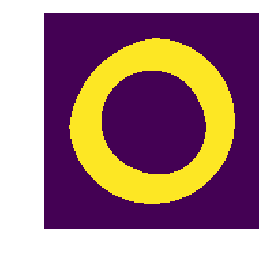

In [250]:
plt.imshow(template)

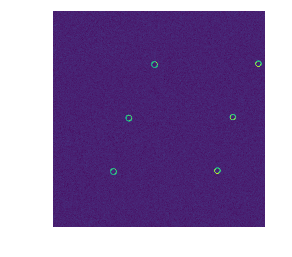

In [251]:
plt.imshow(raw.image.array.T,origin='lower',vmax=400)

In [252]:
from lsst.ts.wep.bsc.DonutDetector import DonutDetector
donut_detect = DonutDetector(template)
donut_df, image_thresh = donut_detect.detectDonuts(raw, overlapDistance,)# image_threshold=22.62402)

In [150]:
#donut_detect.detectDonuts??

In [148]:
np.median(np.sort(np.ravel(raw.image.array)))

0.022880834

In [146]:
np.sort(np.ravel(raw.image.array))

array([-3.9886761e+01, -3.9728924e+01, -3.5602493e+01, ...,
        4.4563150e+02,  4.5825723e+02,  1.0000958e+05], dtype=float32)

In [175]:
y,x = np.where(raw.image.array>1e3)
raw.image.array[y,x]

array([100009.58], dtype=float32)

(array([5.4609e+04, 4.8850e+03, 4.5620e+03, 6.8090e+03, 1.5012e+04,
        1.3606e+04, 5.3280e+03, 8.9000e+02, 3.7000e+01, 1.0000e+00]),
 array([ 20.,  68., 116., 164., 212., 260., 308., 356., 404., 452., 500.],
       dtype=float32),
 <a list of 10 Patch objects>)

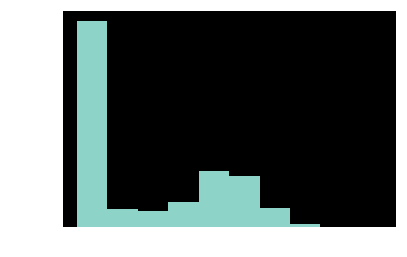

In [136]:
image_threshp.ravel(raw.image.array), range=(20,500))

In [158]:
x

array([1804])

(0, 500)

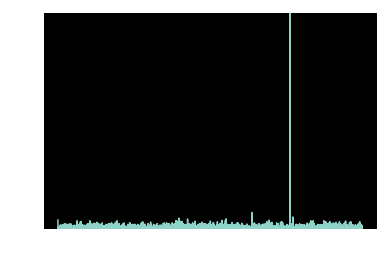

In [177]:
y_high,x_high = np.where(raw.image.array>1e3)
plt.plot(raw.image.array[y_high[0],:])
plt.ylim(0,500)

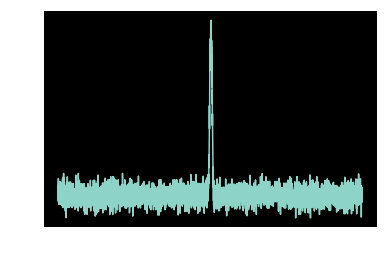

In [163]:
plt.plot(raw.image.array[1500,:])
#plt.ylim(0,500)

Text(0, 0.5, 'px value')

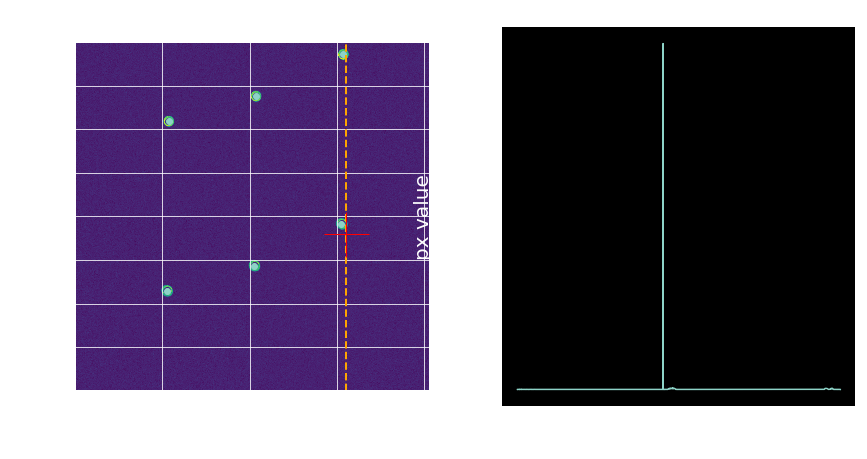

In [253]:
fig,ax = plt.subplots(1,2,figsize=(14,7))
ax[0].imshow(raw.image.array,origin='lower',vmax=400)
ax[0].scatter(donut_df['x_center'],donut_df['y_center'])
ax[0].grid()
y_trace = 1500
x_trace = x_high # 1050
ax[0].axvline(x_trace, ls='--',lw=2,c='orange')

ax[0].plot(x_high, y_high, marker='+', markersize=45, c='r')# ls='--',lw=2,c='orange')
ax[0].set_xlabel('x [px]')
ax[0].set_ylabel('y [px]')

# plot_trace_along_x:
ax[1].plot(raw.image.array[:,x_trace])
ax[1].set_title('trace along x = %d [px]'%x_trace)
ax[1].set_xlabel('y [px]')
ax[1].set_ylabel('px value')

In [229]:
image_trunc = np.sort(np.ravel(raw.image.array))[100:-100]
image_thresh = threshold_triangle(image_trunc)

In [230]:
image_thresh

22.62402

In [225]:
from copy import deepcopy, copy
image  = copy(raw.image.array)

image_ = np.sort(np.ravel(image))

from skimage.filters import threshold_otsu, threshold_triangle, threshold_local

for threshold_method in threshold_otsu, threshold_triangle,:
    threshold  = threshold_method(image_trunc)
    print(threshold_method, threshold)
    
threshold = threshold_local(image_trunc,101)
print(threshold)

<function threshold_otsu at 0x7eff0d053440> 123.47241
<function threshold_triangle at 0x7eff0d053830> 22.62402


ValueError: The parameter `image` must be a 2-dimensional array

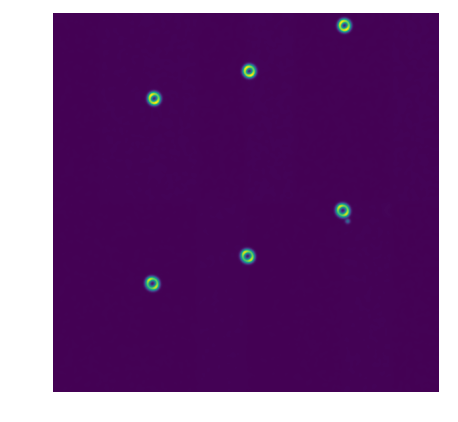

In [208]:
fig,ax = plt.subplots(1,1,figsize=(7,7))
ax.imshow(threshold, origin='lower')

In [210]:
np.unique(raw.mask.array)

array([  0, 512], dtype=int32)

(array([1804, 1804, 1804, 1804, 1804, 1804, 1804, 3804, 3804, 3804, 3804,
        3804, 3804, 3804]),
 array([  49,  558, 1067, 1576, 2085, 2594, 3612,   49,  558, 1067, 1576,
        2594, 3103, 3612]))

In [198]:
print(threshold_local)

<function threshold_local at 0x7eff0d0533b0>


#neighborStarMap, starMap, wavefrontSensors = self.getTargetStar(offset=offset)
#os.listdir(os.getcwd())

In [80]:
#Table.read?

In [85]:
from astropy.table import Table
donuts = Table.read('image_donut_df.csv', )#format='ascii', )

In [86]:
m = (donuts['raft'] == 'R00') * (donuts['sensor'] == 'S22')
donuts[m].to

col0,x_center,y_center,blended,blended_with,num_blended_neighbors,flux,ra,dec,raft,sensor,mag
int64,float64,float64,str5,int64,int64,float64,float64,float64,str3,str3,float64
0,3102.64232710003,2196.3271000296827,False,--,0,34519.15234375,358.7028387876964,-1.1159837405751638,R00,S22,15.0
9,3103.035275175644,2196.009806791569,False,--,0,31823.71484375,358.8140063735943,-1.116059452306362,R00,S22,15.0


In [78]:
foundDonuts = Table.read('foundDonuts.txt', format='csv')

In [79]:
foundDonuts

# Id Ra Decl Mag
str32
0 358.702839 -1.115984 15.000000
1 358.887833 1.184739 15.000000
2 1.104058 -1.293618 15.000000
3 1.179442 1.116349 15.000000
4 1.205652 1.171586 15.000000
5 1.221240 1.226856 15.000000
6 1.313041 1.172164 15.000000
7 1.328634 1.227478 15.000000
8 1.286375 1.116324 15.000000


In [19]:
isrImgMap = wep_calc.wepCntlr.getPostIsrImgMapOnCornerWfs(detector_list, obsIdList[0])

R:0,0 S:2,2,A is intra-focal
R:0,4 S:2,0,A is intra-focal
R:4,0 S:0,2,A is intra-focal
R:4,4 S:0,0,A is intra-focal
R:0,4 S:2,0,B is extra-focal
R:4,4 S:0,0,B is extra-focal


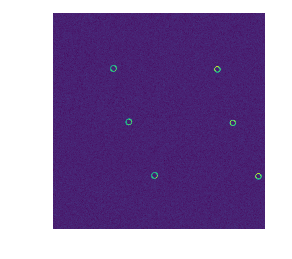

In [29]:
%matplotlib inline
plt.imshow(isrImgMap['R:0,0 S:2,2,A'].getIntraImg(), vmax=400)

In [196]:
import os
import warnings

from lsst.ts.wep.Utility import getModulePath, getConfigDir, BscDbType, \
    FilterType, abbrevDetectorName, getBscDbType, getImageType, \
    getCentroidFindType, ImageType, DefocalType
from lsst.ts.wep.CamDataCollector import CamDataCollector
from lsst.ts.wep.CamIsrWrapper import CamIsrWrapper
from lsst.ts.wep.SourceProcessor import SourceProcessor
from lsst.ts.wep.SourceSelector import SourceSelector
from lsst.ts.wep.WfEstimator import WfEstimator
from lsst.ts.wep.WepController import WepController
from lsst.ts.wep.ctrlIntf.SensorWavefrontData import SensorWavefrontData
from lsst.ts.wep.ParamReader import ParamReader
from lsst.ts.wep.ctrlIntf.MapSensorNameAndId import MapSensorNameAndId

# Inside _getTargetStar()

sourSelc = wep_calc.wepCntlr.getSourSelc()
bscDbType = wep_calc._getBscDbType()
if bscDbType in (BscDbType.LocalDb, BscDbType.LocalDbForStarFile,
             BscDbType.LocalDbFromImage, BscDbType.LocalDbFromRefCat):
    dbRelativePath = wep_calc.settingFile.getSetting("defaultBscPath")
    dbAdress = os.path.join(getModulePath(), dbRelativePath)
    sourSelc.connect(dbAdress)
else:
    raise ValueError("WEPCalculation does not support %s yet." % bscDbType)

# Do the query
sourSelc.setObsMetaData(wep_calc.raInDeg, wep_calc.decInDeg, wep_calc.rotSkyPos)

camDimOffset = wep_calc.settingFile.getSetting("camDimOffset")


    

In [195]:
dbAdress

'/astro/store/epyc/users/suberlak/Commissioning/aos/ts_wep/tests/testData/bsc.db3'

In [197]:
import os

from lsst.ts.wep.bsc.Filter import Filter
from lsst.ts.wep.bsc.CamFactory import CamFactory
from lsst.ts.wep.bsc.DatabaseFactory import DatabaseFactory
from lsst.ts.wep.bsc.LocalDatabaseForStarFile import LocalDatabaseForStarFile
from lsst.ts.wep.bsc.LocalDatabaseFromImage import LocalDatabaseFromImage
from lsst.ts.wep.bsc.LocalDatabaseFromRefCat import LocalDatabaseFromRefCat
from lsst.ts.wep.Utility import mapFilterRefToG, getConfigDir
from lsst.ts.wep.ParamReader import ParamReader
from lsst.ts.wep.ctrlIntf.PhosimWcsSol import PhosimWcsSol
# get inside SourceSelector 
#neighborStarMap = sourSelc.getTargetStarFromImage(
#        self._getButlerRootPath(), visitList, defocalState, offset=camDimOffset)[0]
# self == sourSelc
filterType = sourSelc.getFilter()
mappedFilterType = mapFilterRefToG(filterType)

if type(sourSelc.camera._wcs) == PhosimWcsSol:
    print('PhosimWcsSol')
    sourSelc.camera._wcs.setWcsDataFromIsrDir(mappedFilterType,
                                          sourSelc.camera.getWfsCcdList(),
                                          visitList[0])

sourSelc.db.createTable(mappedFilterType)

In [200]:
visitList = obsIdList
defocalState=DefocalType.Intra
butlerRootPath = wep_calc._getButlerRootPath()
# sourSelc.db.insertDataFromImage(butlerRootPath, sourSelc.settingFile,
#                                     visitList, defocalState,
#                                     mappedFilterType,
#                                     sourSelc.camera, skiprows=1)

{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}


AttributeError: 'tuple' object has no attribute 'query'

In [205]:
# Inside LocalDatabaseFromImage.py 

# .insertDataFromImage(butlerRootPath, sourSelc.settingFile,
#                                     visitList, defocalState,
#                                     mappedFilterType,
#                                     sourSelc.camera, skiprows=1)
#  insertDataFromImage(self, butlerRootPath, settingFileInst,
#                             visitList, defocalState,
#                             filterType, camera,
#                             skiprows=1, keepFile=True,
#                             fileOut='foundDonuts.txt'):

settingFileInst=sourSelc.settingFile 
filterType = mappedFilterType
camera = sourSelc.camera
keepFile=True
fileOut='foundDonuts.txt'
skiprows=1

sourSelc.db.expWcs = settingFileInst.getSetting("expWcs")
centroidTemplateType = settingFileInst.getSetting("centroidTemplateType")
donutImgSize = settingFileInst.getSetting("donutImgSizeInPixel")
overlapDistance = settingFileInst.getSetting("minUnblendedDistance")
maxSensorStars = settingFileInst.getSetting("maxSensorStars")
pix2arcsec = settingFileInst.getSetting("pixelToArcsec")

In [202]:
# skyDf = self.identifyDonuts(butlerRootPath, visitList, filterType,
#                                     defocalState, camera, pix2arcsec,
#                                     centroidTemplateType, donutImgSize,
#                                     overlapDistance, maxSensorStars)

In [207]:
import os
import lsst.daf.persistence as dafPersist
from lsst.ts.wep.bsc.DonutDetector import DonutDetector
from lsst.ts.wep.bsc.LocalDatabaseForStarFile import LocalDatabaseForStarFile
from lsst.ts.wep.cwfs.TemplateUtils import createTemplateImage
from lsst.ts.wep.Utility import abbrevDetectorName, parseAbbrevDetectorName


templateType = centroidTemplateType

butler = dafPersist.Butler(butlerRootPath)
sensorList = butler.queryMetadata('postISRCCD', 'detectorName')
visitOn = visitList[0]
full_unblended_df = None
# detector has 'R:0,0 S:2,2,A' format 
#for detector in camera.getWfsCcdList():
detector = 
    # abbrevName has R00_S22_C0 format
    abbrevName = abbrevDetectorName(detector) 
    raft, sensor = parseAbbrevDetectorName(abbrevName)

    if sensor not in sensorList:
        continue

    data_id = {'visit': visitOn, 'filter': filterType.toString(),
               'raftName': raft, 'detectorName': sensor}
    print(data_id)

    # TODO: Rename this to reflect this is postISR not raw image.
    raw = butler.get('postISRCCD', **data_id)
    template = createTemplateImage(defocalState,
                                   abbrevName, pix2arcsec,
                                   templateType, donutImgSize)

{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R04', 'detectorName': 'S20'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R40', 'detectorName': 'S02'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R44', 'detectorName': 'S00'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R04', 'detectorName': 'S20'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R40', 'detectorName': 'S02'}
{'visit': 9006002, 'filter': 'g', 'raftName': 'R44', 'detectorName': 'S00'}


In [208]:
donut_detect = DonutDetector(template)

In [209]:
donut_df, image_thresh = donut_detect.detectDonuts(raw, overlapDistance)

In [213]:
ranked_unblended_df = donut_detect.rankUnblendedByFlux(donut_df, raw)

In [217]:
ranked_unblended_df = ranked_unblended_df.reset_index(drop=True)

In [220]:
maxSensorStars == "None"

True

try running just the postISR  : 

In [336]:
import os
import argparse
import numpy as np

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18
%matplotlib inline
import matplotlib.pyplot as plt 
plt.style.use('dark_background')

import sys
sys.path.append('../analysis_tools/')
import analysisTools as at

closed_loop_input_dir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/input/'

cmd = 'python runCloseLoopPostISR.py'
args = '--closed_loop_input_dir %s --select_sensor lsstcam --bscDbType image'%(closed_loop_input_dir, )

print('\n Run in terminal:')
print('%s %s'%(cmd,args))


 Run in terminal:
python runCloseLoopPostISR.py --closed_loop_input_dir /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/input/ --select_sensor lsstcam --bscDbType image


Show the resulting postage stamps: 

/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/iter0/postage
Using postage images from /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/iter0/postage
Searching in /astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam_2/iter0/postage directory

Available postage stamp images for sensor R00_S22: 

Looking for files that start with "intra_singleSciImg" and contain "R00_S22"...

Found 2 singleSciImg postage stamp images 
['intra_singleSciImg_sensor-R00_S22_C0_star-0_id-9_posX-1808_posY-3103.txt', 'intra_singleSciImg_sensor-R00_S22_C0_star-0_id-0_posX-1435_posY-2052.txt']

Looking for files that start with "intra_imgDeblend_full" and contain "R00_S22"...

Found 2 imgDeblend_full postage stamp images 
['intra_imgDeblend_full_sen

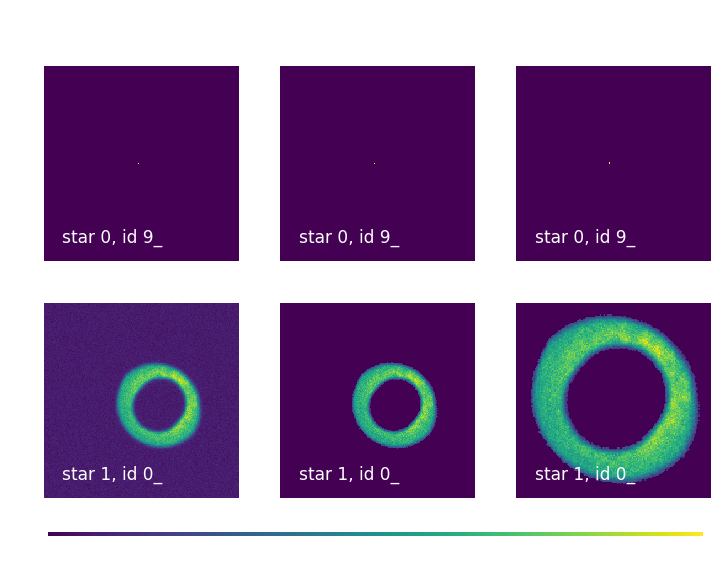

In [246]:

baseOutputDir = closed_loop_input_dir[:-len('/input')]
postage_dir = os.path.join(baseOutputDir, 'iter0', 'postage')
print(postage_dir)
at.plotPostageStamps(postage_dir, sensor='R00_S22', focalType='intra')


1) Check whether x,y --> ra,dec --> x,y  gives the same 

In [249]:
from lsst.sims.utils import ObservationMetaData
from lsst.sims.coordUtils.CameraUtils import raDecFromPixelCoords
from lsst.sims.coordUtils import raDecFromPixelCoordsLSST
from lsst.obs.lsstSim import LsstSimMapper

_sourProc = SourceProcessor()
sensorName = 'R00_S22_C1'
_sourProc.config(sensorName=sensorName)

xInpixelInCam = 500#, 800]
yInPixelInCam = 1000#, 1300]
pixelDmX, pixelDmY = _sourProc.camXY2DmXY(xInpixelInCam,
                                          yInPixelInCam)
print(pixelDmX, pixelDmY)
# Expand the sensor name
expandedSensorName = expandDetectorName(sensorName)

_obs = ObservationMetaData(pointingRA=0, pointingDec=0,
                                        rotSkyPos=0,
                                        mjd=59000)
raInDeg, declInDeg = raDecFromPixelCoords(
    pixelDmX, pixelDmY, expandedSensorName, camera=LsstSimMapper().camera,
    obs_metadata=_obs, epoch=2000,
    includeDistortion=False)

# raInDeg_1, declInDeg_1 = raDecFromPixelCoordsLSST(
#     pixelDmX, pixelDmY, expandedSensorName,
#     obs_metadata=_obs, epoch=2000,
#     includeDistortion=True)


# the other way round: ra,dec --> x,y is not in the SkySim...

1000 1500


In [250]:
# if we use WcsSol.py, it's using https://github.com/lsst-ts/ts_wep/blob/uw_dev/python/lsst/ts/wep/bsc/WcsSol.py 
from lsst.sims.coordUtils.CameraUtils import raDecFromPixelCoords, \
    pixelCoordsFromRaDec, focalPlaneCoordsFromRaDec


xOut, yOut = pixelCoordsFromRaDec(raInDeg, declInDeg, obs_metadata=_obs,
                                    chipName=expandedSensorName, camera=LsstSimMapper().camera,
                                    epoch=2000.0,
                                    includeDistortion=False)
print(xOut,yOut)

999.9999999995598 1500.0000000380824


So with WcsSol.py we get the same out as we put in ... 

In [251]:

topDir = '/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs'
outputDir = os.path.join(topDir,'baselineTest_2020_24_noBkgnd_noContam')
data_dir = outputDir

Check the PhoSim WCS : does it match the input? 

In [252]:
focalType = 'intra'
raft = 'R00'
detector = 'S22'
rerun='run1'
# if Butler args are no provided, attempting to 
# guess based on the following:

sensor = raft+'_'+detector 


# this applies to ComCam ...
detNumDict = {'R22_S00':90, 'R22_S01':91, 'R22_S02':92,   # ComCam detector ids 
              'R22_S10':93, 'R22_S11':94, 'R22_S12':95, 
              'R22_S20':96, 'R22_S21':97, 'R22_S22':98,
              'R00_S22':197,'R04_S20':204,    # WFS detector ids 
              'R40_S02':209, 'R44_S00':216
              }

detNum = detNumDict[sensor]    
# these are decided in baseComcamLoop.py or baseWfsLoop.py 
obsIdDic = {'focal':9006000, 'extra':9006001,  'intra':9006002}

#if not obsId: # if not provided, reading it from a dict, based on the focal type
obsId = obsIdDic[focalType]

# assemble data_id arguments for Butler 
data_id = {'visit': obsId, 'filter': 'g', 'raftName': raft, 
           'detectorName': detector, 'detector': detNum
          }

print('data_id is')
print(data_id)
# Read each figure as a postage stamp, store data to an array 

repo_dir = os.path.join(data_dir, 'input/rerun/', rerun)
print('Reading postISR images from the following repo_dir:')
print(repo_dir)

butler = dafPersist.Butler(repo_dir)

# show what keys are needed by the `postISRCCD` data type.... 
# butler.getKeys('postISRCCD')
# yields {'visit': int, 'filter': str,'raftName': str, 'detectorName': str, 'detector': int}
post = butler.get('postISRCCD', **data_id) 

data_id is
{'visit': 9006002, 'filter': 'g', 'raftName': 'R00', 'detectorName': 'S22', 'detector': 197}
Reading postISR images from the following repo_dir:
/astro/store/epyc/users/suberlak/Commissioning/aos/ts_phosim/notebooks/analysis_scripts/results_wfs/baselineTest_2020_24_noBkgnd_noContam/input/rerun/run1


In [253]:
image = post.image.array
wcs = post.getWcs()

In [254]:
from astropy.table import Table
cat_dir = data_dir
cat_path = os.path.join(cat_dir,'iter0/pert/',  'skyInfo.txt' )
cat = Table.read(cat_path, format='ascii')

Given the WCS from the postISR CCD and the input catalog (ra,dec), we use the WCS to get (x,y):

In [258]:
def radec_to_xy(wcs, ra, dec):
    """
    Convert ra/dec arrays to xy array
    Parameters
    ----------
    wcs : `lsst.afw.geom.SkyWcs`
       WCS object
    ra : `numpy.ndarray`
       Float array of RA positions
    dec : `numpy.ndarray`
       Float array of Dec positions
    Returns
    -------
    xy : `numpy.ndarray`
       2xN array of x/y positions associated with input ra/dec
    """
    xy = wcs.getTransform().getMapping().applyInverse(np.deg2rad(np.vstack((ra, dec))))
    return xy.T


xy = radec_to_xy(wcs, cat['Ra'].data, cat['Decl'].data)

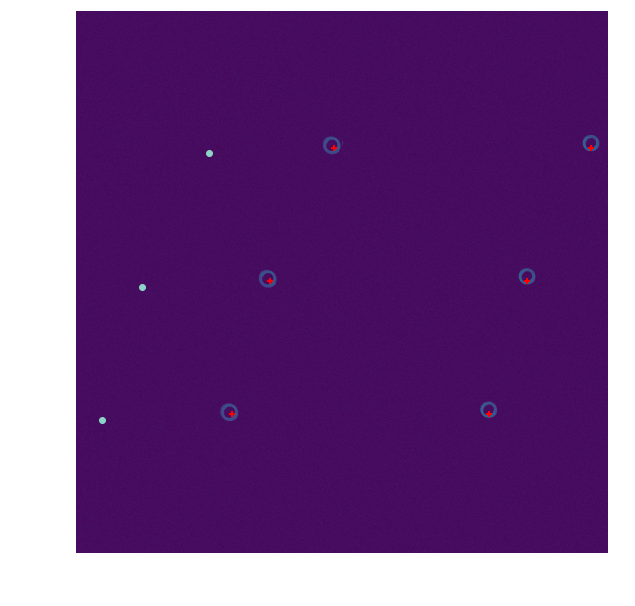

In [262]:

xs = xy[:,0]
ys = xy[:,1]

fig,ax = plt.subplots(1,1,figsize=(10,10))
ax.imshow(image.T, origin='lower', vmax=1200)
ax.set_xlabel('x [px]')
ax.set_ylabel('y [px]')
mx = (0 < xs)*(xs<4000)
my = (0 < ys)*(ys<4000)
mxy = mx*my
args = {'marker':'+', 's':40,'edgecolor':'red', 
         'facecolor':'red', 'linewidth':2}
ax.scatter(ys[mxy],xs[mxy],**args)

xPx = [200,500,1000]
yPx = [1000,2000,3000]
ax.scatter(xPx,yPx)    